# PROJECT EXPECTATIONS

"Download the dataset from your dataset URL

Read the external sources for the dataset to understand the schema and data.

Create a database to store the data.(SQL or NoSQL)

Insert the data into the database. (SQL or NoSQL)

Connect to the database using Python and retrieve the data from the tables (SQL or NoSQL).

Save the data into pandas(or else) dataframe.

Perform exploratory data analysis (EDA) on the data to understand the distribution, trends, and relationships( not limited to you can vary) among variables.

Visualize the data using matplotlib or seaborn(or with different libs).

Apply data analysis techniques like sentiment analysis, topic modeling, or network analysis(or different approaches which fit your dataset) to draw insights.

Write the results back to the database.

Present your project.

Write your project report and submit it."


# About the Dataset

The dataset used for this analysis was downloaded from data.world. it contains 23123 rows and 11 columns. The dataset is all about review for Amazon Uk shoes review by various customers from countries. The aim is to help Amazon understand the habit of it customers towards shoes purchase to help them improve their services that meet their customer requirement and also to help the producer of such shoes understand customer reactions towards pro

<h1> STEP 1: Download the dataset from your dataset URL</h1>

In [3]:
!wget https://data.world/crawlfeeds/amazon-uk-shoes-product-reviews-dataset/file/amazon_uk_shoes_products_dataset_2021_12.csv

<h3> IMPORT THE LIBARIES</h3>

In [462]:
import seaborn as sns
import seaborn;seaborn.set()
import sqlite3
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter(action ='ignore', category =FutureWarning)
import pandas as pd

<H1> STEP 2: Connect to the database using Python.</H1>

create the database file

In [463]:
from pathlib import Path
Path('shoes_review.db').touch()

In [464]:
conn = sqlite3.connect('shoes_review.db')
c = conn.cursor()

<H1>STEP 3: Create SQL database to store the data.</H1>

understand the dataset structure for databse insertion

In [13]:
#amazon_shoes_review = pd.read_csv('/storage/emulated/0/db_pro/shoes.csv')
amazon_shoes_review = pd.read_csv(r'C:\Users\User\PycharmProjects\MSC CONTECH STUDY\shoes.csv',low_memory=False)
amazon_shoes_review.head(3)

,url,product_name,reviewer_name,review_title,review_text,review_rating,verified_purchase,review_date,helpful_count,uniq_id,scraped_at
0,https://www.amazon.co.uk/dp/B07SBX32T5,Klasified Women's Transparent Clear Sneaker Sh...,Jocelyn McSayles,Love em,Love these. Was looking for converses and thes...,5.0,True,Reviewed in the United States on 2 June 2020,2 people found this helpful,36eae4e5-2894-5279-a0b7-d2b330e2b814,2021-12-24T02:26:25
1,https://www.amazon.co.uk/dp/B07SBX32T5,Klasified Women's Transparent Clear Sneaker Sh...,Kenia Rivera,The plastic ripped,"The shoes are very cute, but after the 2nd day...",2.0,True,Reviewed in the United States on 28 October 2021,NaN,f4778bb8-3070-5cb1-b5aa-ffce41a97b57,2021-12-24T02:26:25
2,https://www.amazon.co.uk/dp/B07SBX32T5,Klasified Women's Transparent Clear Sneaker Sh...,Chris Souza,Good quality,Good quality,5.0,True,Reviewed in the United States on 20 January 2021,NaN,db5a7525-d40b-5265-84d8-df4f29837a3b,2021-12-24T02:26:25


In [467]:
c.execute ('''drop table if exists shoes_reviews''')

In [468]:
c.execute('''create table shoes_reviews(uniq_id varchar primary key unique not null, url varchar, product_name varchar, reviewer_name varchar, review_title text,
             review_text varchar, review_rating float, verified_purchase boolean, review_date date, helpful_count varchar,scrapt_date datetime  )''')
amazon_shoes_review = pd.read_csv(r'C:\Users\User\PycharmProjects\MSC CONTECH STUDY\shoes.csv',low_memory=False)
amazon_shoes_review.to_sql('shoes_review', conn, if_exists ='append', index = False)
conn.commit()

<H1>STEP4: Read the external sources for the dataset to understand the schema and data.</H1>

In [469]:
pd.read_sql_query("select * from sqlite_master where type = 'table';",conn)

,type,name,tbl_name,rootpage,sql
0,table,review_analysed,review_analysed,25258,"CREATE TABLE ""review_analysed"" (\n""Unnamed: 0""..."
1,table,ukShoesAmz,ukShoesAmz,270640,"CREATE TABLE ""ukShoesAmz"" (\n""Unnamed: 0"" INTE..."
2,table,shoes_reviews,shoes_reviews,2,CREATE TABLE shoes_reviews(uniq_id varchar pri...
3,table,shoes_review,shoes_review,4,"CREATE TABLE ""shoes_review"" (\n""url"" TEXT,\n ..."


View database data types

In [470]:
c.execute("pragma table_info(shoes_review)").fetchall()

[(0, 'url', 'TEXT', 0, None, 0),
 (1, 'product_name', 'TEXT', 0, None, 0),
 (2, 'reviewer_name', 'TEXT', 0, None, 0),
 (3, 'review_title', 'TEXT', 0, None, 0),
 (4, 'review_text', 'TEXT', 0, None, 0),
 (5, 'review_rating', 'REAL', 0, None, 0),
 (6, 'verified_purchase', 'INTEGER', 0, None, 0),
 (7, 'review_date', 'TEXT', 0, None, 0),
 (8, 'helpful_count', 'TEXT', 0, None, 0),
 (9, 'uniq_id', 'TEXT', 0, None, 0),
 (10, 'scraped_at', 'TEXT', 0, None, 0)]

In [18]:
%cd C:\Users\User\PycharmProjects\MSC CONTECH STUDY

C:\Users\User\PycharmProjects\MSC CONTECH STUDY


In [19]:
%load_ext sql
%sql sqlite:///shoes_review.db
#%sql sqlite:////storage/emulated/0/db_pro/shoes_review.db

In [20]:
%%sql
select *
from shoes_review
limit 5

 * sqlite:///shoes_review.db
Done.


url,product_name,reviewer_name,review_title,review_text,review_rating,verified_purchase,review_date,helpful_count,uniq_id,scraped_at
https://www.amazon.co.uk/dp/B07SBX32T5,"Klasified Women's Transparent Clear Sneaker Shoe, White, 5.5 UK",Jocelyn McSayles,Love em,Love these. Was looking for converses and these were half the price and so unique— I’ve never seen clear shoes like these; they fit great. The plastic takes a little getting used to but the style is so worth it.,5.0,1,Reviewed in the United States on 2 June 2020,2 people found this helpful,36eae4e5-2894-5279-a0b7-d2b330e2b814,2021-12-24T02:26:25
https://www.amazon.co.uk/dp/B07SBX32T5,"Klasified Women's Transparent Clear Sneaker Shoe, White, 5.5 UK",Kenia Rivera,The plastic ripped,"The shoes are very cute, but after the 2nd day of wearing them the tongue started ripping. After the 3rd day of wearing them the plastic on the side ripped. They could have ripped bc I was wearing them to work and I do a lot of walking at work. If you’re going to buy these I don’t recommend wearing them on days where you will do a lot of walking or they might rip",2.0,1,Reviewed in the United States on 28 October 2021,None,f4778bb8-3070-5cb1-b5aa-ffce41a97b57,2021-12-24T02:26:25
https://www.amazon.co.uk/dp/B07SBX32T5,"Klasified Women's Transparent Clear Sneaker Shoe, White, 5.5 UK",Chris Souza,Good quality,Good quality,5.0,1,Reviewed in the United States on 20 January 2021,None,db5a7525-d40b-5265-84d8-df4f29837a3b,2021-12-24T02:26:25
https://www.amazon.co.uk/dp/B07SBX32T5,"Klasified Women's Transparent Clear Sneaker Shoe, White, 5.5 UK",Amazon Customer,Good,Great,5.0,1,Reviewed in the United States on 22 April 2021,None,75a42851-6462-54b5-988a-27d336221943,2021-12-24T02:26:25
https://www.amazon.co.uk/dp/B08SW434MG,"GUESS Women's Bradly Gymnastics Shoe, White, 7 UK",Graziella,PERFETTE!!,"Ho scelto il modello bianco con rifinitura dietro nera e posso dire che da vicino le scarpe sono ancora più belle, il mio numero è 38, 38.5 ed ho ordinato il numero 38 e mi va bene..Spedizione veloce, il pacco è arrivato anche prima del previsto, prezzo ottimo dato che in giro costano almeno 10, 15 euro in più.",5.0,1,Reviewed in Italy on 2 April 2021,2 people found this helpful,232dee43-849e-5d06-ba05-efb3f4814714,2021-12-24T02:26:25


In [21]:
%%sql 
select  count(*) as [Total Rows]
from shoes_review

 * sqlite:///shoes_review.db
Done.


Total Rows
204690


In [22]:
shoes = pd.read_sql("select count(*) as [Total Rows] from shoes_review",conn)
shoes.head

<bound method NDFrame.head of    Total Rows
0      204690>

In [23]:
type(shoes)

pandas.core.frame.DataFrame

display total rowz

In [24]:
%%sql
select *,count() as [Total Rows]
from shoes_review 

 * sqlite:///shoes_review.db
Done.


url,product_name,reviewer_name,review_title,review_text,review_rating,verified_purchase,review_date,helpful_count,uniq_id,scraped_at,Total Rows
https://www.amazon.co.uk/dp/B07SBX32T5,"Klasified Women's Transparent Clear Sneaker Shoe, White, 5.5 UK",Jocelyn McSayles,Love em,Love these. Was looking for converses and these were half the price and so unique— I’ve never seen clear shoes like these; they fit great. The plastic takes a little getting used to but the style is so worth it.,5.0,1,Reviewed in the United States on 2 June 2020,2 people found this helpful,36eae4e5-2894-5279-a0b7-d2b330e2b814,2021-12-24T02:26:25,204690


<h1>STEP 5: Retrieve the data from the SQL tables</h1>

In [25]:
c.execute('''select *
from shoes_review
limit 5''')
c.fetchall()

[('https://www.amazon.co.uk/dp/B07SBX32T5',
  "Klasified Women's Transparent Clear Sneaker Shoe, White, 5.5 UK",
  'Jocelyn McSayles',
  'Love em',
  'Love these. Was looking for converses and these were half the price and so unique— I’ve never seen clear shoes like these; they fit great. The plastic takes a little getting used to but the style is so worth it.',
  5.0,
  1,
  'Reviewed in the United States on 2 June 2020',
  '2 people found this helpful',
  '36eae4e5-2894-5279-a0b7-d2b330e2b814',
  '2021-12-24T02:26:25'),
 ('https://www.amazon.co.uk/dp/B07SBX32T5',
  "Klasified Women's Transparent Clear Sneaker Shoe, White, 5.5 UK",
  'Kenia Rivera',
  'The plastic ripped',
  'The shoes are very cute, but after the 2nd day of wearing them the tongue started ripping. After the 3rd day of wearing them the plastic on the side ripped. They could have ripped bc I was wearing them to work and I do a lot of walking at work. If you’re going to buy these I don’t recommend wearing them on days w

In [26]:
ukshoes = pd.read_sql("select * from shoes_review", conn)

In [27]:
ukshoes.head(2)

,url,product_name,reviewer_name,review_title,review_text,review_rating,verified_purchase,review_date,helpful_count,uniq_id,scraped_at
0,https://www.amazon.co.uk/dp/B07SBX32T5,Klasified Women's Transparent Clear Sneaker Sh...,Jocelyn McSayles,Love em,Love these. Was looking for converses and thes...,5.0,1,Reviewed in the United States on 2 June 2020,2 people found this helpful,36eae4e5-2894-5279-a0b7-d2b330e2b814,2021-12-24T02:26:25
1,https://www.amazon.co.uk/dp/B07SBX32T5,Klasified Women's Transparent Clear Sneaker Sh...,Kenia Rivera,The plastic ripped,"The shoes are very cute, but after the 2nd day...",2.0,1,Reviewed in the United States on 28 October 2021,None,f4778bb8-3070-5cb1-b5aa-ffce41a97b57,2021-12-24T02:26:25


<h1>STEP 6: Save the data into pandas(or else) dataframe.</h1>

In [28]:
shoesCsv = ukshoes.to_csv(r"uk_shoes_review.csv",index = False)

<H1>STEP 7: Perform exploratory data analysis (EDA) on the data to understand the distribution, trends, and relationships( not limited to you can vary) among variables.</H1>

Reading the dataframe

In [29]:
amzReview = pd.read_csv('uk_shoes_review.csv',low_memory=False)

In [30]:
amzReview.sample(10)

,url,product_name,reviewer_name,review_title,review_text,review_rating,verified_purchase,review_date,helpful_count,uniq_id,scraped_at
200483,https://www.amazon.co.uk/dp/B07PFK9S6Y,New Balance Roav V1 Fresh Foam Lace Up Running...,Claire Domingue,Item did not last,I bought these in July for my daughter to star...,3.0,1,Reviewed in the United States on 22 October 2021,NaN,050af895-cae4-5cdf-9e97-010cddcc94ee,2021-12-24T02:27:42
31544,https://www.amazon.co.uk/dp/B07JJTY5V2,Timberland Unisex Kid's Davis Square TD Eurosp...,ale80,In anticipo ma con un piccolo difetto,Arrivate prima del previsto. Apparentemente di...,3.0,1,Reviewed in Italy on 30 November 2020,NaN,91e3ef65-062e-5b96-8d3a-8f819d09388a,2021-12-24T02:28:26
44572,https://www.amazon.co.uk/dp/B08CDRFZWX,"Teva Men's M Original Universal, Topanga Olive...",Bryan Corlett,TEVA sandals,"They came quickly and to the door, good fit, l...",4.0,1,Reviewed in Germany on 9 July 2021,NaN,67bc912f-c0e9-5c99-98cc-19d5d30efc88,2021-12-24T02:28:11
120636,https://www.amazon.co.uk/dp/B08K354QZB,ACE Constructor High S3 Work Boots - Mens Leat...,Cliente Amazon,Muy duras y malas para trabajar en el transporte,Despues de 2 días intensos de trabajo las teng...,1.0,1,Reviewed in Spain on 14 November 2020,NaN,6f8d5564-dd84-5e81-b222-ebae90e692df,2021-12-24T02:28:36
150920,https://www.amazon.co.uk/dp/B07B94KWFG,"New Balance 519v1 Running Shoe, Black/Rainbow,...",Unttextbooks,NB Shoes,I purchased these for my daughter who wears a ...,1.0,1,Reviewed in the United States on 23 February 2019,One person found this helpful,abd739fc-e3b7-54ee-b2b7-5fba4b68f49a,2021-12-24T02:26:46
187448,https://www.amazon.co.uk/dp/B08R9BLCLB,"ECCO Men's Soft Classic Boot Sneaker, Navy Sue...",happybuyer,Awesome shoe,"Fits great, comfortable, and very stylish. My...",5.0,1,Reviewed in the United States on 12 November 2021,NaN,54f67abd-e0ec-5356-b430-9de2f6f45ae6,2021-12-24T02:28:02
166705,https://www.amazon.co.uk/dp/B07DV4ZQBS,"Columbia Women's Crestwood Hiking Shoe, Mud/Re...",I. M.A.,Vale la pena muy buenos,Súper bonitos para usarse hasta para ir al súp...,5.0,1,Reviewed in Mexico on 19 September 2019,One person found this helpful,8174a6fb-99d2-5b31-9675-71462cc818f0,2021-12-24T02:27:53
63745,https://www.amazon.co.uk/dp/B07S811GBP,"adidas Men's Strutter Shoes Cross Trainer, Gre...",Eve Siebos,Great,Comfortable,5.0,1,Reviewed in Canada on 6 August 2020,NaN,2af64669-c0d1-54a7-9d2e-9fb5605fd8e1,2021-12-24T02:27:33
141872,https://www.amazon.co.uk/dp/B07ZR1PH6J,"adidas Baby D.O.N. Issue 2 Basketball Shoe, Pi...",Dorian Jesus,Excelente precio,"Excelente llegó antes de lo esperado, muy buen...",5.0,1,Reviewed in Mexico on 23 November 2020,NaN,bd68b413-81d8-58a6-89a2-e088cdda5460,2021-12-24T02:28:53
199423,https://www.amazon.co.uk/dp/B0785NMZKB,"adidas Kids' VS Switch 2 Sneaker, Dark Blue/Wh...",Mary,Wrong color description and size runs small,Disappointed in these. Size runs very small an...,3.0,1,Reviewed in the United States on 26 January 2020,NaN,747ad07e-7901-53cc-98b1-5518bc074d7a,2021-12-24T02:27:04


Statistics Summary

In [31]:
amzReview.describe()

,review_rating,verified_purchase
count,204690.000000,204690.000000
mean,4.132493,0.998095
std,1.336874,0.043608
min,1.000000,0.000000
25%,4.000000,1.000000
50%,5.000000,1.000000
75%,5.000000,1.000000
max,5.000000,1.000000


In [32]:
amzReview.select_dtypes('object').describe()

,url,product_name,reviewer_name,review_title,review_text,review_date,helpful_count,uniq_id,scraped_at
count,204690,204690,204690,204660,204420,204690,58590,204690,204690
unique,1087,1086,5483,5464,6537,3877,55,6641,194
top,https://www.amazon.co.uk/dp/B08BT2WPVB,"Teva K Hurricane 3, Balboa Sodalite Blue, 12 U...",Amazon Customer,Five Stars,Love them,Reviewed in the United States on 2 July 2021,One person found this helpful,e14c62fa-0562-5d7d-b662-3809768550ae,2021-12-24T02:28:48
freq,300,300,9540,2010,270,330,25560,60,2490


In [33]:
amzReview.describe(include ="all")

,url,product_name,reviewer_name,review_title,review_text,review_rating,verified_purchase,review_date,helpful_count,uniq_id,scraped_at
count,204690,204690,204690,204660,204420,204690.000000,204690.000000,204690,58590,204690,204690
unique,1087,1086,5483,5464,6537,NaN,NaN,3877,55,6641,194
top,https://www.amazon.co.uk/dp/B08BT2WPVB,"Teva K Hurricane 3, Balboa Sodalite Blue, 12 U...",Amazon Customer,Five Stars,Love them,NaN,NaN,Reviewed in the United States on 2 July 2021,One person found this helpful,e14c62fa-0562-5d7d-b662-3809768550ae,2021-12-24T02:28:48
freq,300,300,9540,2010,270,NaN,NaN,330,25560,60,2490
mean,NaN,NaN,NaN,NaN,NaN,4.132493,0.998095,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,1.336874,0.043608,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,1.000000,0.000000,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,4.000000,1.000000,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,5.000000,1.000000,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,5.000000,1.000000,NaN,NaN,NaN,NaN


Info about the data including the null values and the data types

In [34]:
amzReview.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 204690 entries, 0 to 204689
Data columns (total 11 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   url                204690 non-null  object 
 1   product_name       204690 non-null  object 
 2   reviewer_name      204690 non-null  object 
 3   review_title       204660 non-null  object 
 4   review_text        204420 non-null  object 
 5   review_rating      204690 non-null  float64
 6   verified_purchase  204690 non-null  int64  
 7   review_date        204690 non-null  object 
 8   helpful_count      58590 non-null   object 
 9   uniq_id            204690 non-null  object 
 10  scraped_at         204690 non-null  object 
dtypes: float64(1), int64(1), object(9)
memory usage: 17.2+ MB


In [35]:
amzReview.shape

(204690, 11)

In [36]:
amzReview.isnull().sum()

url                       0
product_name              0
reviewer_name             0
review_title             30
review_text             270
review_rating             0
verified_purchase         0
review_date               0
helpful_count        146100
uniq_id                   0
scraped_at                0
dtype: int64

In [37]:
amzReview.isnull() == True

,url,product_name,reviewer_name,review_title,review_text,review_rating,verified_purchase,review_date,helpful_count,uniq_id,scraped_at
0,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,True,False,False
2,False,False,False,False,False,False,False,False,True,False,False
3,False,False,False,False,False,False,False,False,True,False,False
4,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...
204685,False,False,False,False,False,False,False,False,True,False,False
204686,False,False,False,False,False,False,False,False,True,False,False
204687,False,False,False,False,False,False,False,False,True,False,False
204688,False,False,False,False,False,False,False,False,True,False,False


In [38]:
amzReview[amzReview.isnull()==True]

,url,product_name,reviewer_name,review_title,review_text,review_rating,verified_purchase,review_date,helpful_count,uniq_id,scraped_at
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
204685,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
204686,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
204687,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
204688,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN



Misssing values Percentage

In [39]:
missing_per = round(amzReview.isnull().sum()/len(amzReview)*100,1)
display(missing_per)

url                   0.0
product_name          0.0
reviewer_name         0.0
review_title          0.0
review_text           0.1
review_rating         0.0
verified_purchase     0.0
review_date           0.0
helpful_count        71.4
uniq_id               0.0
scraped_at            0.0
dtype: float64

check missing value for helpful_count column in sql

In [40]:
%%sql SELECT 
     SUM(CASE WHEN helpful_count IS NULL THEN 1 ELSE 0 END) AS null_value_count      
    ,COUNT(helpful_count) AS non_null_value_count
FROM shoes_review

 * sqlite:///shoes_review.db
Done.


null_value_count,non_null_value_count
146100,58590


Visualizing missing values

In [41]:
import missingno as msno
%matplotlib inline

<AxesSubplot:>

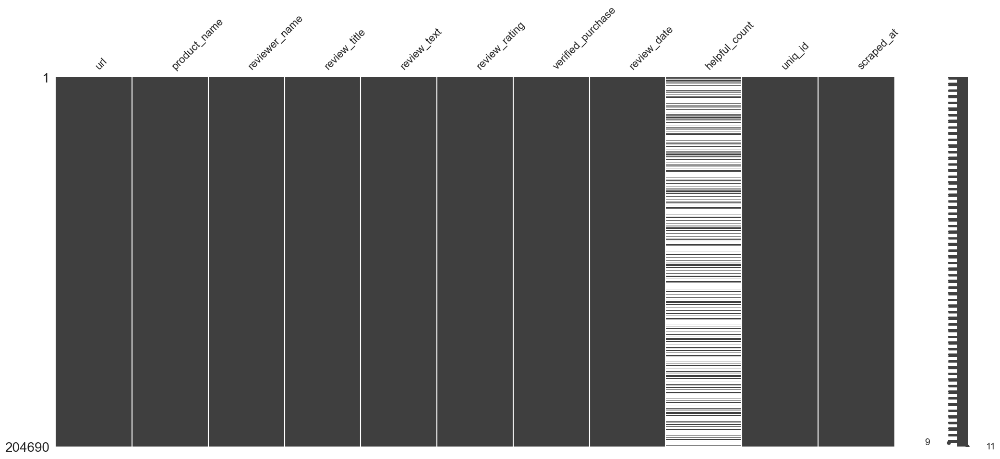

In [42]:
msno.matrix(amzReview)

<AxesSubplot:>

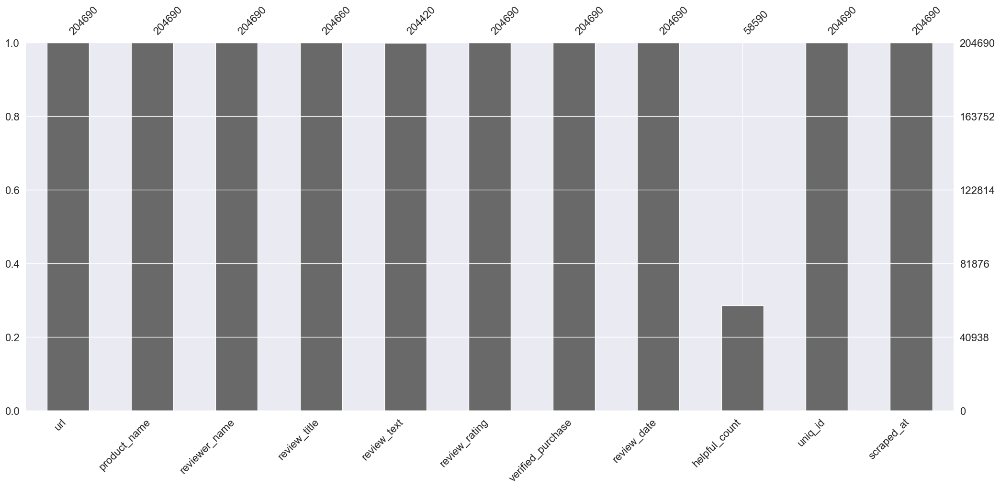

In [43]:
msno.bar(amzReview)

<AxesSubplot:>

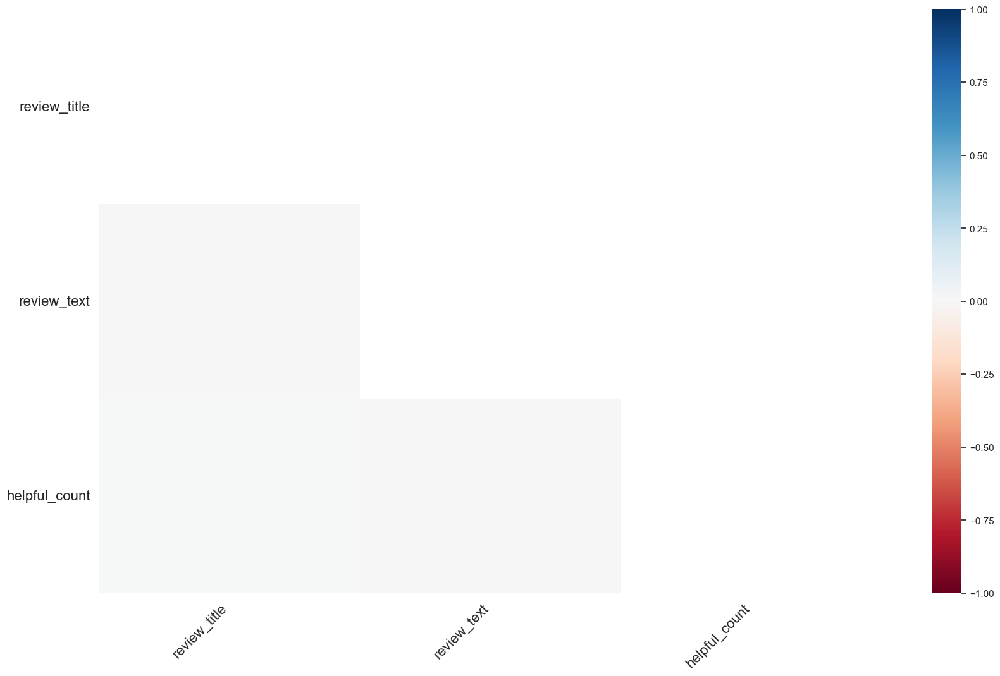

In [44]:
msno.heatmap(amzReview)

Drop Columns whoes null value is greater than 40%

In [45]:
thresh = missing_per[missing_per>40] 
thresh

helpful_count    71.4
dtype: float64

In [46]:
dropped_null = amzReview.drop(columns="helpful_count",inplace=True)

Check if helpful_review column was successfully dropped

In [47]:
amzReview.head(1)

,url,product_name,reviewer_name,review_title,review_text,review_rating,verified_purchase,review_date,uniq_id,scraped_at
0,https://www.amazon.co.uk/dp/B07SBX32T5,Klasified Women's Transparent Clear Sneaker Sh...,Jocelyn McSayles,Love em,Love these. Was looking for converses and thes...,5.0,1,Reviewed in the United States on 2 June 2020,36eae4e5-2894-5279-a0b7-d2b330e2b814,2021-12-24T02:26:25


In [48]:
amzReview[amzReview.duplicated()]

,url,product_name,reviewer_name,review_title,review_text,review_rating,verified_purchase,review_date,uniq_id,scraped_at
6823,https://www.amazon.co.uk/dp/B07SBX32T5,Klasified Women's Transparent Clear Sneaker Sh...,Jocelyn McSayles,Love em,Love these. Was looking for converses and thes...,5.0,1,Reviewed in the United States on 2 June 2020,36eae4e5-2894-5279-a0b7-d2b330e2b814,2021-12-24T02:26:25
6824,https://www.amazon.co.uk/dp/B07SBX32T5,Klasified Women's Transparent Clear Sneaker Sh...,Kenia Rivera,The plastic ripped,"The shoes are very cute, but after the 2nd day...",2.0,1,Reviewed in the United States on 28 October 2021,f4778bb8-3070-5cb1-b5aa-ffce41a97b57,2021-12-24T02:26:25
6825,https://www.amazon.co.uk/dp/B07SBX32T5,Klasified Women's Transparent Clear Sneaker Sh...,Chris Souza,Good quality,Good quality,5.0,1,Reviewed in the United States on 20 January 2021,db5a7525-d40b-5265-84d8-df4f29837a3b,2021-12-24T02:26:25
6826,https://www.amazon.co.uk/dp/B07SBX32T5,Klasified Women's Transparent Clear Sneaker Sh...,Amazon Customer,Good,Great,5.0,1,Reviewed in the United States on 22 April 2021,75a42851-6462-54b5-988a-27d336221943,2021-12-24T02:26:25
6827,https://www.amazon.co.uk/dp/B08SW434MG,"GUESS Women's Bradly Gymnastics Shoe, White, 7 UK",Graziella,PERFETTE!!,Ho scelto il modello bianco con rifinitura die...,5.0,1,Reviewed in Italy on 2 April 2021,232dee43-849e-5d06-ba05-efb3f4814714,2021-12-24T02:26:25
...,...,...,...,...,...,...,...,...,...,...
204685,https://www.amazon.co.uk/dp/B07TPYWFVN,"Clarks Vennor Wing, Men’s Low-Top Sneakers, Bl...",mauti72,Schick und leicht,"Schicker Schuh, läuft sich gut.",5.0,1,Reviewed in Germany on 15 October 2020,0850eae1-fa2f-59e6-bf30-ad49151bfa20,2021-12-24T02:29:39
204686,https://www.amazon.co.uk/dp/B07TPYWFVN,"Clarks Vennor Wing, Men’s Low-Top Sneakers, Bl...",Charles Lechesnier,EXCELLENT,Mieux que je ne l'imaginais. Très bonne taille...,5.0,1,Reviewed in France on 23 August 2020,4bf117ed-ea7c-517c-967c-2aee3f80ed29,2021-12-24T02:29:39
204687,https://www.amazon.co.uk/dp/B084WB2D93,"Rohde Men's Tivoli-H Mule, 82 Anthracite, 12.5 UK",Rebecca Lützenkirchen,Einfach schöne Hausschuhe,Habe sie als Geschenk gekauft und sie sind seh...,5.0,1,Reviewed in Germany on 4 October 2021,5b129eb2-a438-5377-9c46-217a177615b2,2021-12-24T02:29:39
204688,https://www.amazon.co.uk/dp/B084WB2D93,"Rohde Men's Tivoli-H Mule, 82 Anthracite, 12.5 UK",Sergej Friedel,Langlebig.,Trage diese Hausschuhe fast zwei Monate jeden ...,5.0,1,Reviewed in Germany on 31 January 2021,91144305-98db-5a55-8ec4-16a253beb811,2021-12-24T02:29:39


Check for duplicate in dataset

In [49]:
amzReview[amzReview.duplicated()].count()

url                  197867
product_name         197867
reviewer_name        197867
review_title         197838
review_text          197606
review_rating        197867
verified_purchase    197867
review_date          197867
uniq_id              197867
scraped_at           197867
dtype: int64

In [50]:
#amzReview["verified_purchase"] = amzReview["verified_purchase"].replace("verified_purchase","purchase_status")

<h3>Data Cleaning</h3>

Replace 1 with True and 0 with False in the verified column

In [51]:
amzReview["verified_purchase"] = amzReview["verified_purchase"].replace(1,"Verified")
amzReview["verified_purchase"] = amzReview["verified_purchase"].replace(0,"Unverified")

In [52]:
amzReview.rename(columns={"verified_purchase":"purchase_status"} ,inplace =True) 

See the changes

In [53]:
amzReview.sample(2)

,url,product_name,reviewer_name,review_title,review_text,review_rating,purchase_status,review_date,uniq_id,scraped_at
324,https://www.amazon.co.uk/dp/B08R61DD9K,"GUESS Women's 668 Sneaker, New Blushing, 4.5 UK",Amazon Customer,Súper satisfecha,Están súper hermosas me quedar perfecta 🤩 vol...,5.0,Verified,Reviewed in the United States on 14 April 2021,0b454017-7473-52bd-a8bc-333b6a7af682,2021-12-24T02:26:32
58184,https://www.amazon.co.uk/dp/B08MWVCZHW,New Balance Women's Fresh Foam EVOZ v1 Road Ru...,Aunt,QUIETSCHT!,"Ich fand den Schuh sehr schön, genauso wie ich...",3.0,Verified,Reviewed in Germany on 29 September 2021,1be24e20-b783-53ad-b8b3-74b14a313f76,2021-12-24T02:28:10


Selecting the columns for analysis

In [54]:
amzReview.columns

Index(['url', 'product_name', 'reviewer_name', 'review_title', 'review_text',
       'review_rating', 'purchase_status', 'review_date', 'uniq_id',
       'scraped_at'],
      dtype='object')

In [55]:
amzRefined = amzReview.copy()

In [56]:
amzRefined =amzReview[['product_name', 'reviewer_name', 'review_title', 'review_text','review_rating', 'purchase_status', 'review_date', 'scraped_at','uniq_id']]

View the data

In [57]:
amzRefined.head(2)

,product_name,reviewer_name,review_title,review_text,review_rating,purchase_status,review_date,scraped_at,uniq_id
0,Klasified Women's Transparent Clear Sneaker Sh...,Jocelyn McSayles,Love em,Love these. Was looking for converses and thes...,5.0,Verified,Reviewed in the United States on 2 June 2020,2021-12-24T02:26:25,36eae4e5-2894-5279-a0b7-d2b330e2b814
1,Klasified Women's Transparent Clear Sneaker Sh...,Kenia Rivera,The plastic ripped,"The shoes are very cute, but after the 2nd day...",2.0,Verified,Reviewed in the United States on 28 October 2021,2021-12-24T02:26:25,f4778bb8-3070-5cb1-b5aa-ffce41a97b57


View the data types again

In [58]:
amzRefined.dtypes

product_name        object
reviewer_name       object
review_title        object
review_text         object
review_rating      float64
purchase_status     object
review_date         object
scraped_at          object
uniq_id             object
dtype: object

CLEAN THE REVIEW_DATE COLUMN AND CREATE REVIEW_COUNTRY COLUMN FROM IT

Split the text into date and text data from review_date column

In [59]:
amzRefined["review_country"] = amzReview["review_date"].str.split('(\d+)')

View 5 samples of the data to see the changes

In [60]:
amzRefined['review_country'].sample(5)


138856         [Reviewed in Italy on , 6,  August , 2021, ]
442         [Reviewed in Spain on , 28,  February , 2021, ]
6304      [Reviewed in the United States on , 23,  June ...
74302         [Reviewed in Italy on , 12,  August , 2021, ]
101546    [Reviewed in the United States on , 7,  Novemb...
Name: review_country, dtype: object

Get the first index of the string and save it in review_country column

In [61]:
amzRefined['review_country'] = amzRefined['review_country'].str[0]

Replace the review_country column string 'on' with nothing 

In [62]:
amzRefined['review_country'] = amzRefined['review_country'].str.replace('on','')

See changes

In [63]:
amzRefined.sample(1)

,product_name,reviewer_name,review_title,review_text,review_rating,purchase_status,review_date,scraped_at,uniq_id,review_country
173545,Nanga Sandburg Slippers Unisex-Child blue Bleu...,NeeWe:),Tolle Hausschuhe,Auf diese Hausschuhe bin ich aufgrund einer Em...,5.0,Verified,Reviewed in Germany on 13 May 2021,2021-12-24T02:27:54,e1c4a8e9-c90e-5075-82ef-5f2b0f7801c3,Reviewed in Germany


Split text again to seperate date from text

In [64]:
amzRefined["review_date"] = amzRefined["review_date"].str.split('(\d+)')
amzRefined['review_date'] = amzRefined['review_date'].str[1:]
amzRefined['review_date'].sample(10)

1519         [30,  August , 2021, ]
62408     [15,  September , 2020, ]
28688          [7,  March , 2021, ]
153756          [12,  May , 2020, ]
87642          [10,  July , 2021, ]
128783          [2,  July , 2020, ]
23268         [6,  August , 2017, ]
31393       [4,  February , 2020, ]
100493         [10,  July , 2020, ]
79389        [4,  October , 2017, ]
Name: review_date, dtype: object

Store result in review_date column

Merge the 3 created columns together to make up the review_date content

In [65]:
date = list(amzRefined['review_date'])
Date = pd.DataFrame(date)
Date.columns = ["daily_review","monthly_review","yearly_review","g"]
Date.reset_index(drop = True)
date_ = Date.daily_review+ " "+Date.monthly_review+" "+Date.yearly_review

In [66]:
amzRefined['review_date'] = date_

Replace month strings to numerical ones

In [67]:
amzRefined['review_date'] = amzRefined['review_date'].str.replace("January","1")
amzRefined['review_date'] = amzRefined['review_date'].str.replace("February","2")
amzRefined['review_date'] = amzRefined['review_date'].str.replace("March","3")
amzRefined['review_date'] = amzRefined['review_date'].str.replace("April","4")
amzRefined['review_date'] = amzRefined['review_date'].str.replace("May","5")
amzRefined['review_date'] = amzRefined['review_date'].str.replace("June","6")
amzRefined['review_date'] = amzRefined['review_date'].str.replace("July","7")
amzRefined['review_date'] = amzRefined['review_date'].str.replace("August","8")
amzRefined['review_date'] = amzRefined['review_date'].str.replace("September","9")
amzRefined['review_date'] = amzRefined['review_date'].str.replace("October","10")
amzRefined['review_date'] = amzRefined['review_date'].str.replace("November","11")
amzRefined['review_date'] = amzRefined['review_date'].str.replace("December","12")

View Changes

In [68]:
amzRefined.review_date

0           2  6  2020
1         28  10  2021
2          20  1  2021
3          22  4  2021
4           2  4  2021
              ...     
204685    15  10  2020
204686     23  8  2020
204687     4  10  2021
204688     31  1  2021
204689     27  1  2021
Name: review_date, Length: 204690, dtype: object

Remove unneccessary texts from review_country and store the result in review_country

In [69]:
amzRefined['review_country'] = amzRefined['review_country'].str.replace('the','')
amzRefined['review_country'] = amzRefined['review_country'].str.replace('Reviewed in','')

Convert date to datetime data type

In [70]:
amzRefined.review_date = pd.to_datetime(amzRefined.review_date)

View Changes

In [71]:
amzRefined.review_date

0        2020-02-06
1        2021-10-28
2        2021-01-20
3        2021-04-22
4        2021-02-04
            ...    
204685   2020-10-15
204686   2020-08-23
204687   2021-04-10
204688   2021-01-31
204689   2021-01-27
Name: review_date, Length: 204690, dtype: datetime64[ns]

Set datetinme as index for time-series anlysis

In [72]:
amzRefined.head(3)

,product_name,reviewer_name,review_title,review_text,review_rating,purchase_status,review_date,scraped_at,uniq_id,review_country
0,Klasified Women's Transparent Clear Sneaker Sh...,Jocelyn McSayles,Love em,Love these. Was looking for converses and thes...,5.0,Verified,2020-02-06,2021-12-24T02:26:25,36eae4e5-2894-5279-a0b7-d2b330e2b814,United States
1,Klasified Women's Transparent Clear Sneaker Sh...,Kenia Rivera,The plastic ripped,"The shoes are very cute, but after the 2nd day...",2.0,Verified,2021-10-28,2021-12-24T02:26:25,f4778bb8-3070-5cb1-b5aa-ffce41a97b57,United States
2,Klasified Women's Transparent Clear Sneaker Sh...,Chris Souza,Good quality,Good quality,5.0,Verified,2021-01-20,2021-12-24T02:26:25,db5a7525-d40b-5265-84d8-df4f29837a3b,United States


Drop the reset and drop index

In [73]:
amzRefined = amzRefined.reset_index(drop=True)
amzRefined.head(3)

,product_name,reviewer_name,review_title,review_text,review_rating,purchase_status,review_date,scraped_at,uniq_id,review_country
0,Klasified Women's Transparent Clear Sneaker Sh...,Jocelyn McSayles,Love em,Love these. Was looking for converses and thes...,5.0,Verified,2020-02-06,2021-12-24T02:26:25,36eae4e5-2894-5279-a0b7-d2b330e2b814,United States
1,Klasified Women's Transparent Clear Sneaker Sh...,Kenia Rivera,The plastic ripped,"The shoes are very cute, but after the 2nd day...",2.0,Verified,2021-10-28,2021-12-24T02:26:25,f4778bb8-3070-5cb1-b5aa-ffce41a97b57,United States
2,Klasified Women's Transparent Clear Sneaker Sh...,Chris Souza,Good quality,Good quality,5.0,Verified,2021-01-20,2021-12-24T02:26:25,db5a7525-d40b-5265-84d8-df4f29837a3b,United States


Convert to categorical data type

In [74]:
amzRefined[['review_rating','product_name','review_country','purchase_status']] = amzRefined[['review_rating','product_name','review_country','purchase_status']].astype('category')    

In [75]:
amzRefined.dtypes

product_name             category
reviewer_name              object
review_title               object
review_text                object
review_rating            category
purchase_status          category
review_date        datetime64[ns]
scraped_at                 object
uniq_id                    object
review_country           category
dtype: object

Data Cleaned and Ready for Analysis

<h2>Eploratory Data Analysis(EDA)</h2>

<h3>Understanding the Distributions by visualisation</h3>

Understanding the outliers

[Text(0, 0.0, '0'),
 Text(0, 25000.0, '1'),
 Text(0, 50000.0, '2'),
 Text(0, 75000.0, '3'),
 Text(0, 100000.0, '4'),
 Text(0, 125000.0, '5'),
 Text(0, 150000.0, '6'),
 Text(0, 175000.0, '7'),
 Text(0, 200000.0, '8'),
 Text(0, 225000.0, '9')]

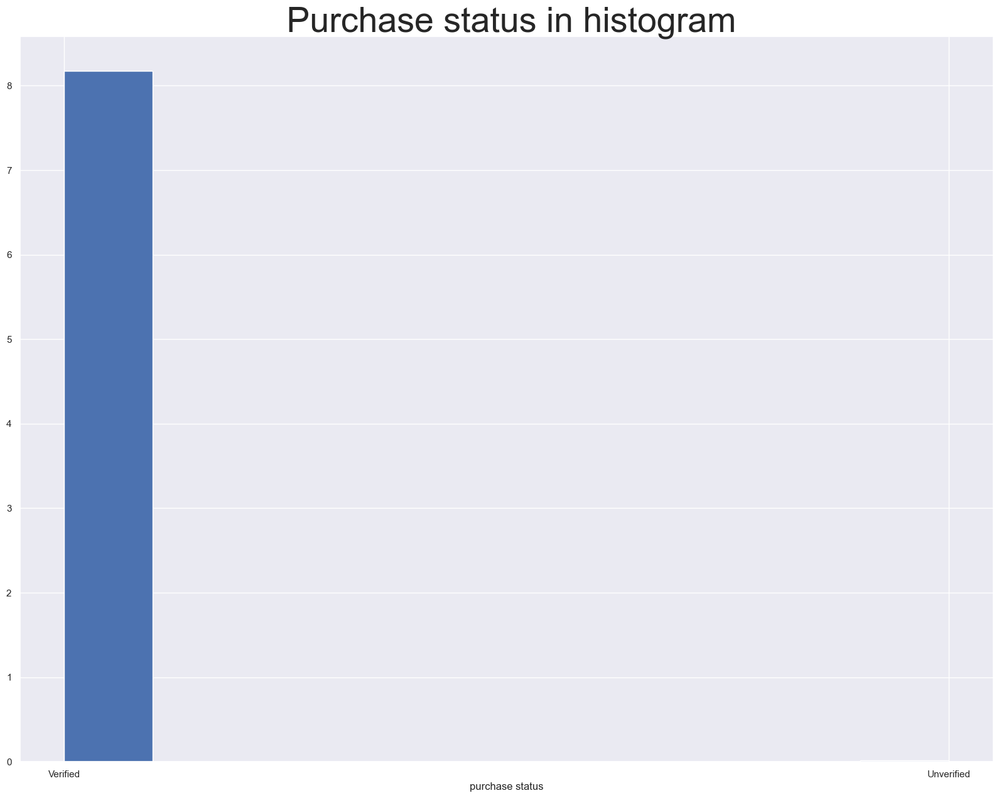

In [76]:
import seaborn;seaborn.set()
r=amzRefined.index

fig, ax = plt.subplots(figsize = (20,15))
amzRefined.purchase_status.hist()
plt.xlabel('purchase status')
plt.title(' Purchase status in histogram',fontsize =40)
ax.set_yticklabels(r)

<AxesSubplot:title={'center':'Rating '}, xlabel='Rating '>

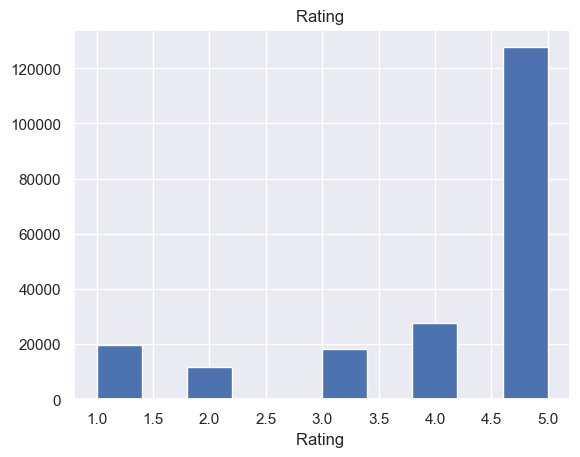

In [77]:
plt.title('Rating ')
plt.xlabel('Rating ')
amzRefined.review_rating.hist()

I am not considering the outlier because we are dealing with categorical variable and various countries citizens have different rating habit.Some may decide to give their ratings while some may not

<h2>How Many purchases were verified?</h2>

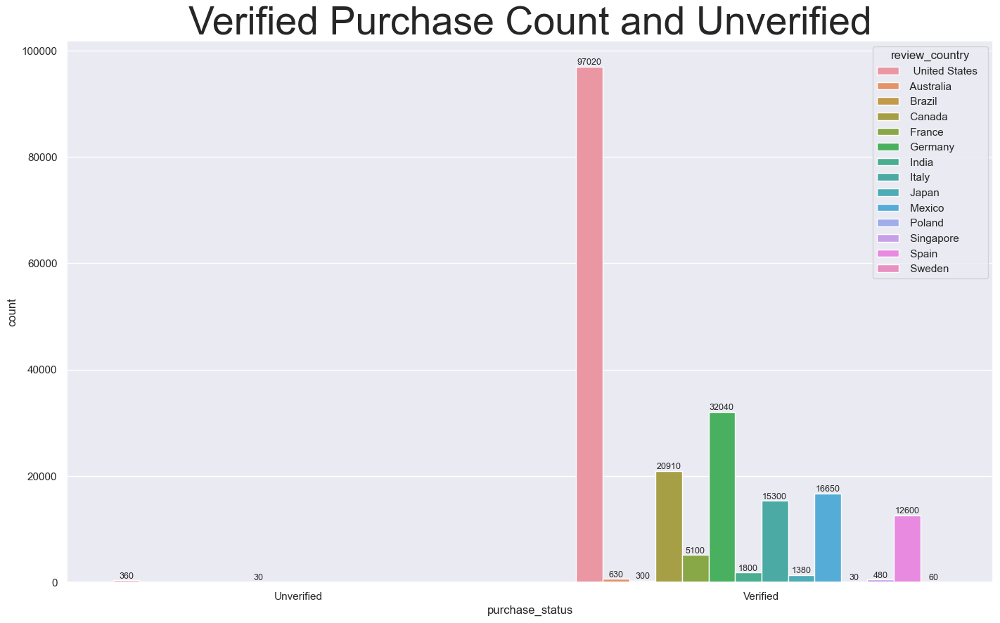

In [78]:
fig, ax = plt.subplots(figsize=(17,10))
ax.set_title('Verified Purchase Count and Unverified',fontsize = 40)
ax=sns.countplot(data=amzRefined,x='purchase_status',hue='review_country')

for l in ax.containers:
    
    ax.bar_label(l,fontsize=9)

<h2>Verified and Unverified Purchase count</h2>

In [79]:
vu=amzRefined.groupby(by=['purchase_status'])['review_country'].value_counts()

vu = pd.DataFrame(vu)
vu.rename(columns={'review_country':'rating_count'},inplace=True)
vu

rating_count
purchase_status                                
Unverified        United States             360
                 Germany                     30
                 Australia                    0
                 Brazil                       0
                 Canada                       0
                 France                       0
                 India                        0
                 Italy                        0
                 Japan                        0
                 Mexico                       0
                 Poland                       0
                 Singapore                    0
                 Spain                        0
                 Sweden                       0
Verified          United States           97020
                 Germany                  32040
                 Canada                   20910
                 Mexico                   16650
                 Italy                    15300
                 Spain                    12600
                 France                    5100
                 India                     1800
                 Japan                     1380
                 Australia                  630
                 Singapore                  480
                 Brazil                     300
                 Sweden                      60
                 Poland                      30

<h4> Purchase status proportion(%)</h4>

In [80]:
vup=(vu/vu.sum())*100
vup=pd.DataFrame(vup)
#vup.reset_index(drop=True)
#vuc=vup.rename(columns={'rating_count':'rating_proportion'},inplace=True)
vup

rating_count
purchase_status                                
Unverified        United States        0.175876
                 Germany               0.014656
                 Australia             0.000000
                 Brazil                0.000000
                 Canada                0.000000
                 France                0.000000
                 India                 0.000000
                 Italy                 0.000000
                 Japan                 0.000000
                 Mexico                0.000000
                 Poland                0.000000
                 Singapore             0.000000
                 Spain                 0.000000
                 Sweden                0.000000
Verified          United States       47.398505
                 Germany              15.652939
                 Canada               10.215448
                 Mexico                8.134252
                 Italy                 7.474718
                 Spain                 6.155650
                 France                2.491573
                 India                 0.879379
                 Japan                 0.674190
                 Australia             0.307783
                 Singapore             0.234501
                 Brazil                0.146563
                 Sweden                0.029313
                 Poland                0.014656

In [81]:
amzRefined.purchase_status.value_counts(normalize=True)

Verified      0.998095
Unverified    0.001905
Name: purchase_status, dtype: float64

In [82]:
c=amzRefined.groupby(by=['review_date','purchase_status','product_name'])['review_country'].value_counts()
c

review_date  purchase_status  product_name                                                                                              
2010-04-22   Verified         Gola Women's Harrier Sneaker, Dark Green/Lime/Ecru, 4                                      United States      30
                                                                                                                        Australia            0
                                                                                                                        Brazil               0
                                                                                                                        Canada               0
                                                                                                                        France               0
                                                                                                                                            ..
2021-

Purchase first verification date

In [83]:
count = amzRefined.groupby('purchase_status').min()
count

,reviewer_name,review_date,scraped_at,uniq_id
purchase_status,,,,
Unverified,B. McCarthy,2020-05-08,2021-12-24T02:26:52,0c186dc7-d339-5eaa-8c17-804ab9c53c0f
Verified,"""ratedmosquito""",2010-04-22,2021-12-24T02:26:25,00156aad-6284-59a0-ad9b-3be819373fb4


Purchase last verification date

In [84]:
count = amzRefined.groupby('purchase_status').max()
count

,reviewer_name,review_date,scraped_at,uniq_id
purchase_status,,,,
Unverified,Siobhan E,2021-11-24,2021-12-24T02:28:46,fae418d3-24cd-567f-99d8-e18de0f252a9
Verified,🖤,2021-12-20,2021-12-24T02:29:39,fffb6949-12ed-5576-8838-1790fc5c118e


<h2>Get the mean</h2>

In [85]:
amzRefined.groupby(by=['purchase_status'])['review_country'].value_counts(normalize=True)

purchase_status                   
Unverified         United States      0.923077
                  Germany             0.076923
                  Australia           0.000000
                  Brazil              0.000000
                  Canada              0.000000
                  France              0.000000
                  India               0.000000
                  Italy               0.000000
                  Japan               0.000000
                  Mexico              0.000000
                  Poland              0.000000
                  Singapore           0.000000
                  Spain               0.000000
                  Sweden              0.000000
Verified           United States      0.474890
                  Germany             0.156828
                  Canada              0.102349
                  Mexico              0.081498
                  Italy               0.074890
                  Spain               0.061674
                  France 

[Text(0, 0, '390'), Text(0, 0, '204300')]

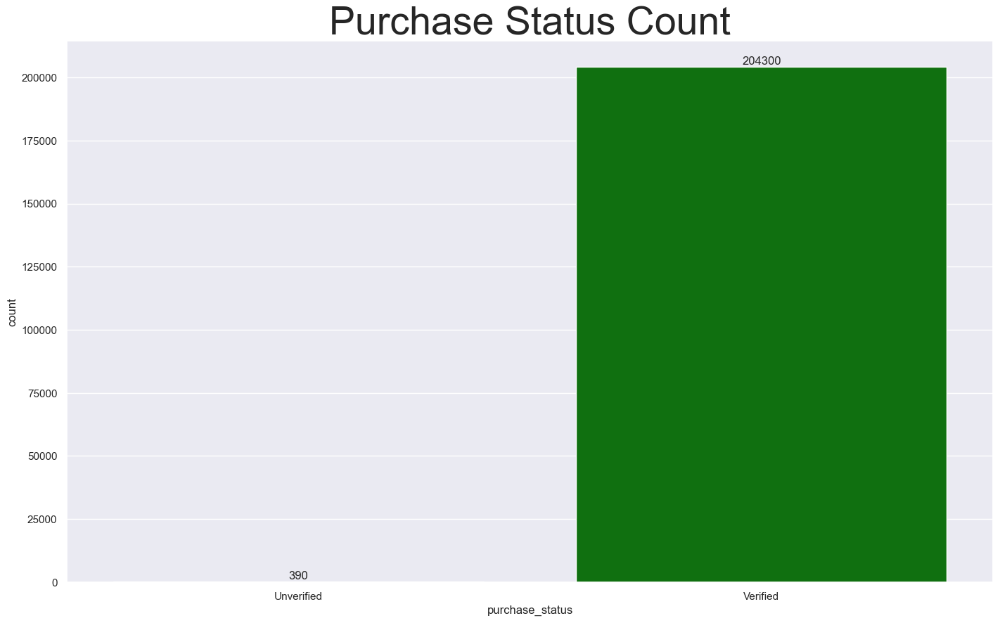

In [86]:
fig, ax = plt.subplots(figsize=(17,10))
ax.set_title('Purchase Status Count',fontsize = 40)
ax=sns.countplot(data=amzRefined,x='purchase_status',color='green')
#ax.set_xticklabels(["Unverified","Verified"])
ax.bar_label(ax.containers[0])

<h2> Total Verified and unverified proportion</h2>

In [87]:
vp=amzRefined.purchase_status.value_counts()
per = (vp/vp.sum())*100
per

Verified      99.809468
Unverified     0.190532
Name: purchase_status, dtype: float64

In [ ]:
# catplot

sns.catplot(data=amzRefined,x='review_date',y='review_country',hue='review_rating')
plt.title('Rating by countries and Year',fontsize=20)
 
plt.show()

<h3> Proportion of all country activities</h3>

In [89]:
cp= amzRefined.value_counts(normalize=True)
#c = (c/c.sum())*100
c =cp.reset_index(drop=False)
c.rename(columns={0:"proportion"},inplace=True)
c

,product_name,reviewer_name,review_title,review_text,review_rating,purchase_status,review_date,scraped_at,uniq_id,review_country,proportion
0,"': 'ZAPATILLA NEW BALANCE KV220, Navy/White, 9...",Client d'Amazon,Parfaites!!,Ma fille de 4 ans est ravie!,5.0,Verified,2018-04-11,2021-12-24T02:28:57,b8197836-87b1-5f35-bbe1-a9fb5633c1ff,France,0.000147
1,"Reebok Women's Split Flex Cross Trainer, Buff/...",Jharitssa Gilbert,Tiras,Los zapatos son muy lindos pero aprietan esas ...,1.0,Verified,2020-10-13,2021-12-24T02:28:08,0b240c76-857a-5a3f-b73f-9dc531c25436,United States,0.000147
2,"Reebok Women's Sole Fury TS Cross Trainer, Whi...",swray,Not good for exercising,These shoes look great and I enjoy the lack sh...,3.0,Verified,2020-05-22,2021-12-24T02:27:13,e5ee2fb1-1193-5bcf-9749-31363dd84926,United States,0.000147
3,"Reebok Women's Sole Fury TS Cross Trainer, Whi...",pamela,Not a cross training sneaker,They are very comfortable and fit as expected....,2.0,Verified,2020-05-19,2021-12-24T02:27:13,f3234f8f-62b6-5564-841d-8f478b71de9f,United States,0.000147
4,"Reebok Women's Sole Fury TS Cross Trainer, Whi...",Tye,Comfortable,These shoes are really good for runners. The s...,5.0,Verified,2021-06-03,2021-12-24T02:27:13,24e15e00-3350-5b20-9f7b-c9ddd843ef3c,United States,0.000147
...,...,...,...,...,...,...,...,...,...,...,...
6808,Lethato Men’s Modern Classic Calfskin Leather ...,Harman,"Tight, odd colour but good leather",The shoe is of good leather and strong. Howeve...,3.0,Verified,2020-03-11,2021-12-24T02:27:34,5fd7df73-89d2-5e33-9625-091c7ff887c1,United States,0.000147
6809,Lethato Men’s Modern Classic Calfskin Leather ...,D. Mendoza,Dressy Silhouette but a Sole for Business,I was a little cautious at first. $99 for calf...,5.0,Verified,2018-10-28,2021-12-24T02:27:34,7b8c0350-d204-5a1e-9b0c-2a99d74f6675,United States,0.000147
6810,Lethato Men’s Modern Classic Calfskin Leather ...,Amazon Customer,Upper sole hurts the heel of foot,"This is a beautiful shoe, the top of the shoe ...",1.0,Verified,2021-08-17,2021-12-24T02:27:34,212852d2-5aea-5955-bf7d-e7b4f0833504,United States,0.000147
6811,"Legero Women's Harmony Trainer, Pepe 3500, 8.5 UK",Kundin aus Oberhausen,Schöne Farbe genau wie Abgebildet,"Hab viele von Legero, als SneakerDieser ist Ma...",5.0,Verified,2021-11-26,2021-12-24T02:28:30,215023e7-c0c3-5af4-8803-d807ac4704ac,Germany,0.000147


<h2> Visualizing Country Rating</h2>

<AxesSubplot:title={'center':'What is the trend in customer rating for various country?'}, xlabel='review_date', ylabel='review_country'>

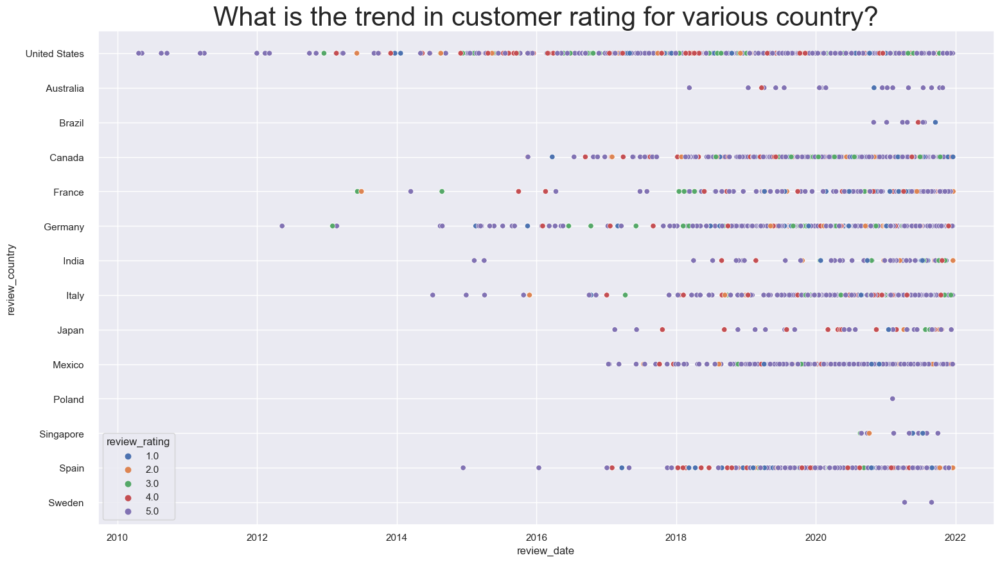

In [90]:
plt.figure(figsize = (18,10))
plt.title('What is the trend in customer rating for various country?',fontsize=30)
sns.scatterplot( x = "review_date", 
                 y = "review_country", 
                 data = amzRefined, 
                 hue = "review_rating")

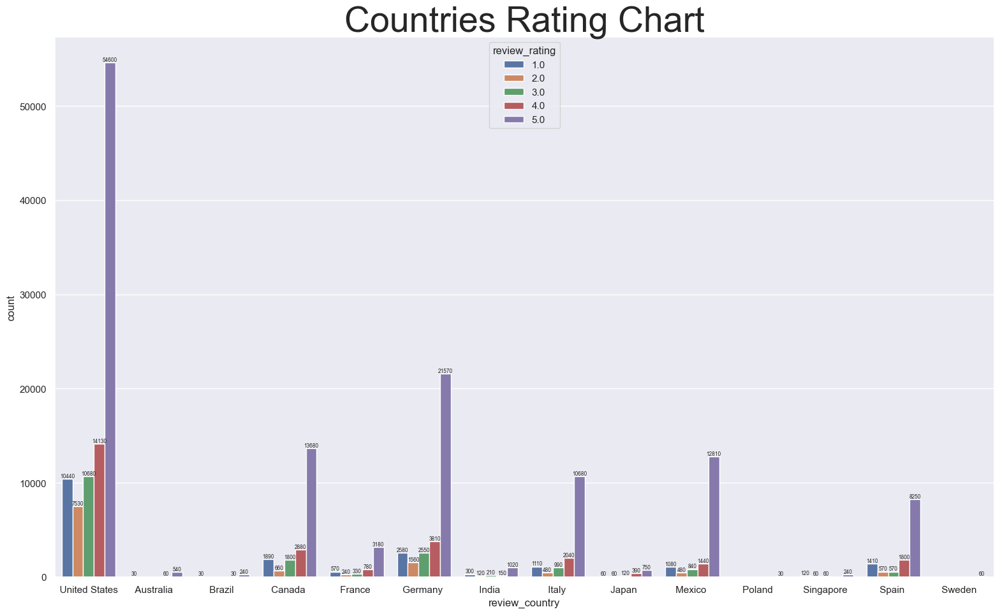

In [91]:
import matplotlib.pyplot as plt
fig, ax= plt.subplots(figsize = (19,11))
sns.countplot(data=amzRefined,x='review_country',hue='review_rating')
ax.set_title('Countries Rating Chart',fontsize = 40)
#ax.set_yticks(amzRefined.review_date)
for x in ax.containers:
    ax.bar_label(x,fontsize=6)

In [92]:
amzRefined['review']= amzRefined.review_rating.astype('float').copy()

<h2>Which products has the highest(5 star) rating with a verified purchase</h2>

In [93]:
# Five Star Rating

five=amzRefined[(amzRefined.review_rating == 5.0) & (amzRefined.purchase_status == 'Verified')]
five=five.groupby(by=['review_country',five.product_name,'review_rating'])['uniq_id'].count()
five=five.reset_index()
five=five.rename(columns={'uniq_id':'product_count'})
five.nlargest(60,'product_count')

,review_country,product_name,review_rating,product_count
29319,Germany,MARCO TOZZI Women's 2-2-23783-26 Damen Sneaker...,5.0,300
31464,Germany,"Superfit Girls' Emily Sandal, Blue Pink 8000, ...",5.0,300
50194,Mexico,Fila Women's Memory Speedstride Trail Running ...,5.0,300
52004,Mexico,"PUMA Unisex-Adult CARACAL Sneaker, White/Black...",5.0,300
254,United States,Allonsi | Thomas Mens Genuine Leather Chelsea ...,5.0,270
739,United States,"Clarks - Mens Un Larvik Top2 Boots, 10 UK, Gre...",5.0,270
2654,United States,New Balance Kids&#39; 574v1 Sport Sneaker,5.0,270
3164,United States,PUMA Unisex-child Roma Gents Sneaker,5.0,270
3779,United States,"Rocket Dog Women's GIAPS-001 Sneaker, Black, 9 UK",5.0,270
3839,United States,"SAS Men's, Journey Mesh Walking Sneakers Gray ...",5.0,270


Top 10 Products with 5 star review

In [94]:
top5 = five.nlargest(5,'product_count')
top5

,review_country,product_name,review_rating,product_count
29319,Germany,MARCO TOZZI Women's 2-2-23783-26 Damen Sneaker...,5.0,300
31464,Germany,"Superfit Girls' Emily Sandal, Blue Pink 8000, ...",5.0,300
50194,Mexico,Fila Women's Memory Speedstride Trail Running ...,5.0,300
52004,Mexico,"PUMA Unisex-Adult CARACAL Sneaker, White/Black...",5.0,300
254,United States,Allonsi | Thomas Mens Genuine Leather Chelsea ...,5.0,270


<h4> Let us Visualise the top 5 products</h4>

<AxesSubplot:title={'center':'Top 5 Rated Product'}, xlabel='product_count', ylabel='review_country'>

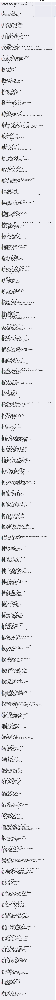

In [95]:
plt.title('Top 5 Rated Product',fontsize=20)
sns.scatterplot(data=top5,y='review_country',x='product_count',hue='product_name')

<h3> Which products were verified and rated below 5tar?</h3>

In [96]:
sta=amzRefined[(amzRefined.review <= 4.0) & (amzRefined.purchase_status == 'Verified')]
sta1=sta.groupby(by=['review_country',sta.product_name,'review_rating'])['uniq_id'].count()
sta2=sta1.reset_index()
sta2=sta2.rename(columns={'uniq_id':'product_count'})
sta2['product_%'] =(sta2.product_count/sta2.product_count.sum())*100
sta2.nlargest(60,'product_count')

,review_country,product_name,review_rating,product_count,product_%
29230,Germany,"Lico Fremont Cross Country Running Shoe, Marin...",1.0,210,0.272904
483,United States,"Bloch Women's Broadway Hi Dance Shoe, Tan, 8.5 UK",4.0,180,0.233918
3668,United States,"Reebok Women's RCF LITE LO TR Poly-W, Citrus G...",4.0,180,0.233918
572,United States,Brooks Womens Range Running Shoe - Oyster Mush...,3.0,150,0.194932
3420,United States,Propet Women's W3910 Vista Walker Comfort Shoe...,1.0,150,0.194932
3910,United States,Saucony Kids&#39; Astrofoam Sneaker,1.0,150,0.194932
70568,Spain,"victoria Unisex 106500-women Hi-Top Trainers, ...",4.0,150,0.194932
20,United States,"ANNE KLEIN Women's Terri Sneaker, Grey Heather...",1.0,120,0.155945
137,United States,"ASICS GT-II Retro Running Shoe, Black/Black, 4...",3.0,120,0.155945
543,United States,Braided Flip Flop Cross Strap Slingback Sandal...,4.0,120,0.155945


<h3>What is the percentage of the unverified products</h3>

In [97]:
stas=amzRefined[(amzRefined.review >= 1.0) & (amzRefined.purchase_status == 'Unverified')]
stax=stas.groupby(by=['review_country',stas.product_name,'review_rating'])['uniq_id'].count()
stax=stax.reset_index()
stax=stax.rename(columns={'uniq_id':'product_count'})
stax['product_%'] =(stax.product_count/stax.product_count.sum())*100
stax.nlargest(50,'product_count')

,review_country,product_name,review_rating,product_count,product_%
1334,United States,Florsheim Kids Baby Boy&#39;s Great Lakes Spor...,5.0,180,46.153846
2134,United States,"Lucky Brand Women's Sarey Boot Ankle, Falcon, ...",5.0,90,23.076923
1333,United States,Florsheim Kids Baby Boy&#39;s Great Lakes Spor...,4.0,60,15.384615
2131,United States,"Lucky Brand Women's Sarey Boot Ankle, Falcon, ...",2.0,30,7.692308
28854,Germany,"HÖGL Women's Element Sneaker, Natural Sunflowe...",5.0,30,7.692308
0,United States,"': 'ZAPATILLA NEW BALANCE KV220, Navy/White, 9...",1.0,0,0.000000
1,United States,"': 'ZAPATILLA NEW BALANCE KV220, Navy/White, 9...",2.0,0,0.000000
2,United States,"': 'ZAPATILLA NEW BALANCE KV220, Navy/White, 9...",3.0,0,0.000000
3,United States,"': 'ZAPATILLA NEW BALANCE KV220, Navy/White, 9...",4.0,0,0.000000
4,United States,"': 'ZAPATILLA NEW BALANCE KV220, Navy/White, 9...",5.0,0,0.000000


[Text(0, 0, '0'),
 Text(0, 0, '0'),
 Text(0, 0, '0'),
 Text(0, 0, '0'),
 Text(0, 0, '0'),
 Text(0, 0, '0'),
 Text(0, 0, '0'),
 Text(0, 0, '0'),
 Text(0, 0, '0'),
 Text(0, 0, '0'),
 Text(0, 0, '0'),
 Text(0, 0, '0'),
 Text(0, 0, '0'),
 Text(0, 0, '0')]

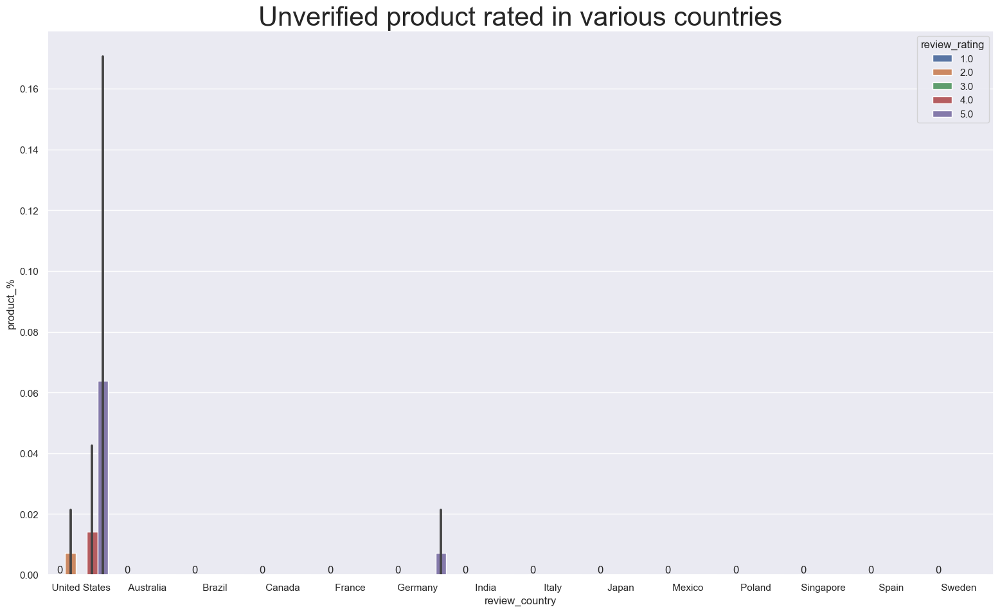

In [98]:
fig, ax= plt.subplots(figsize = (19,11))
plt.title('Unverified product rated in various countries',fontsize=30)
sns.barplot(data=stax,y='product_%',x='review_country',hue='review_rating')
ax.bar_label(ax.containers[0])

<h3>Countries that gave a 5-star review count</h3>

In [99]:
fiv=amzRefined[amzRefined.review_rating==5.0]
fiv.reset_index()


topf=fiv.review_country.value_counts()

topf5 = pd.DataFrame(topf)
topf5['5star_rating(%)']=(topf/topf.sum())*100

topf5.rename(columns={'review_country':'rating_count'},inplace =True)

topf5

,rating_count,5star_rating(%)
United States,54600,42.773208
Germany,21570,16.897767
Canada,13680,10.716804
Mexico,12810,10.035253
Italy,10680,8.366627
Spain,8250,6.462985
France,3180,2.491187
India,1020,0.799060
Japan,750,0.587544
Australia,540,0.423032


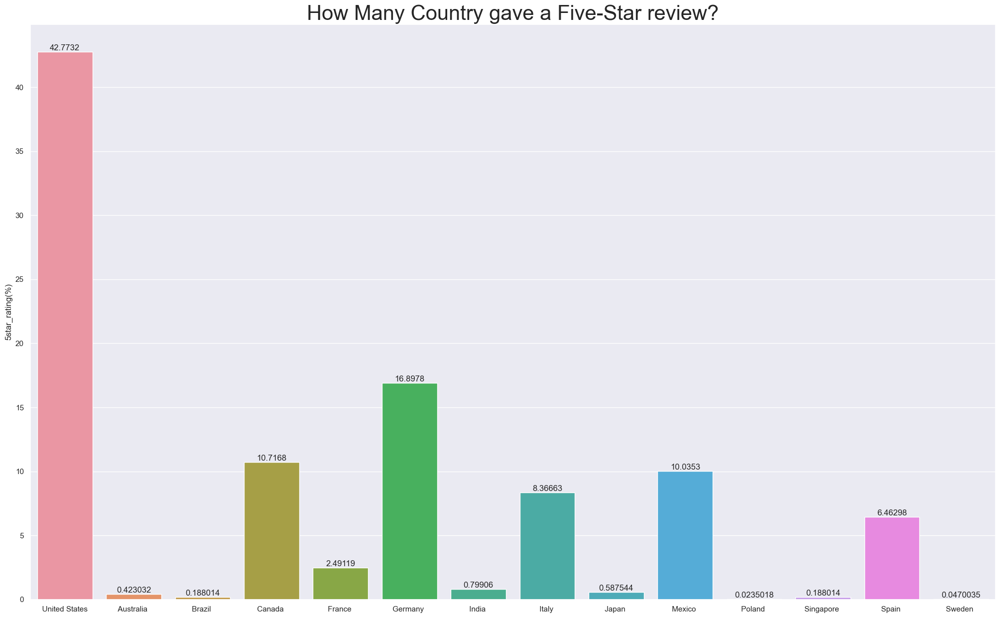

In [100]:
ax=plt.rcParams['figure.figsize'] = (25,15)
plt.title('How Many Country gave a Five-Star review?',fontsize=30)
ax=sns.barplot(data=topf5,x=topf5.index,y='5star_rating(%)')
#ax.set_yticklabels(fiveStar.review_rating)
ax.bar_label(ax.containers[0])
plt.show()

<h2>Countries Rating Count</h2>

In [101]:
_3star = amzRefined[(amzRefined.review >=1.0) & (amzRefined.purchase_status == 'Verified')].value_counts()

_3star=_3star.reset_index(drop=False)
_str3=pd.DataFrame(_3star)
_str3 = _str3.review.value_counts()
_str3


5.0    4240
4.0     915
1.0     651
3.0     603
2.0     391
Name: review, dtype: int64

<h3>How many countries rated between 1.0 and 4.0?</h3>

In [102]:

star=amzRefined[(amzRefined.review <=4.0 ) & (amzRefined.purchase_status == 'Verified')]
#star.reset_index()


stars=star.groupby('review')['review_country'].value_counts()
stars =pd.DataFrame(stars)

stars['rating(%)']=(stars/stars.sum())*100


stars.rename(columns={'review_country':'rating_count'},inplace =True)

stars =pd.DataFrame(stars)
display(stars)

rating_count  rating(%)
review                                           
1.0      United States           10440  13.567251
        Germany                   2580   3.352827
        Canada                    1890   2.456140
        Spain                     1410   1.832359
        Italy                     1110   1.442495
        Mexico                    1080   1.403509
        France                     570   0.740741
        India                      300   0.389864
        Singapore                  120   0.155945
        Japan                       60   0.077973
        Australia                   30   0.038986
        Brazil                      30   0.038986
        Poland                       0   0.000000
        Sweden                       0   0.000000
2.0      United States            7500   9.746589
        Germany                   1560   2.027290
        Canada                     660   0.857700
        Spain                      570   0.740741
        Italy                      480   0.623782
        Mexico                     480   0.623782
        France                     240   0.311891
        India                      120   0.155945
        Japan                       60   0.077973
        Singapore                   60   0.077973
        Australia                    0   0.000000
        Brazil                       0   0.000000
        Poland                       0   0.000000
        Sweden                       0   0.000000
3.0      United States           10680  13.879142
        Germany                   2550   3.313840
        Canada                    1800   2.339181
        Italy                      990   1.286550
        Mexico                     840   1.091618
        Spain                      570   0.740741
        France                     330   0.428850
        India                      210   0.272904
        Japan                      120   0.155945
        Singapore                   60   0.077973
        Australia                    0   0.000000
        Brazil                       0   0.000000
        Poland                       0   0.000000
        Sweden                       0   0.000000
4.0      United States           14070  18.284600
        Germany                   3810   4.951267
        Canada                    2880   3.742690
        Italy                     2040   2.651072
        Spain                     1800   2.339181
        Mexico                    1440   1.871345
        France                     780   1.013645
        Japan                      390   0.506823
        India                      150   0.194932
        Australia                   60   0.077973
        Brazil                      30   0.038986
        Poland                       0   0.000000
        Singapore                    0   0.000000
        Sweden                       0   0.000000

<h3> Which country gave 4.0 review and less</h3>

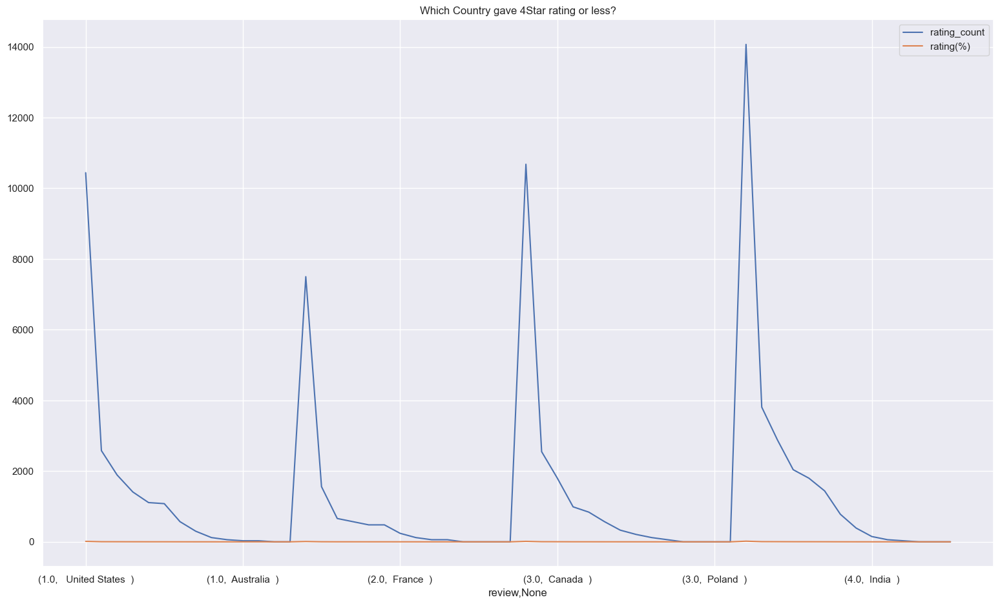

In [103]:
fig, ax =plt.rcParams['figure.figsize'] = (19,11)

stars.plot(title="Which Country gave 4Star rating or less?")
plt.show()


<h2> Countries Rating Count</h2>

In [104]:
Ratings = amzRefined.groupby(by=['review_date',"review_country"])["uniq_id"].count()
Rating = Ratings.reset_index()
Rating.columns=['review_date',"Country","Rating_count"]
Rating= Rating[Rating.Rating_count != 0]
Rating['rating(%)'] = (Rating.Rating_count/Rating.Rating_count.sum())*100
Rating

,review_date,Country,Rating_count,rating(%)
0,2010-04-22,United States,30,0.014656
14,2010-05-09,United States,30,0.014656
28,2010-08-18,United States,30,0.014656
42,2010-09-17,United States,30,0.014656
56,2011-03-10,United States,30,0.014656
...,...,...,...,...
21980,2021-12-20,United States,60,0.029313
21984,2021-12-20,France,30,0.014656
21987,2021-12-20,Italy,30,0.014656
21989,2021-12-20,Mexico,30,0.014656


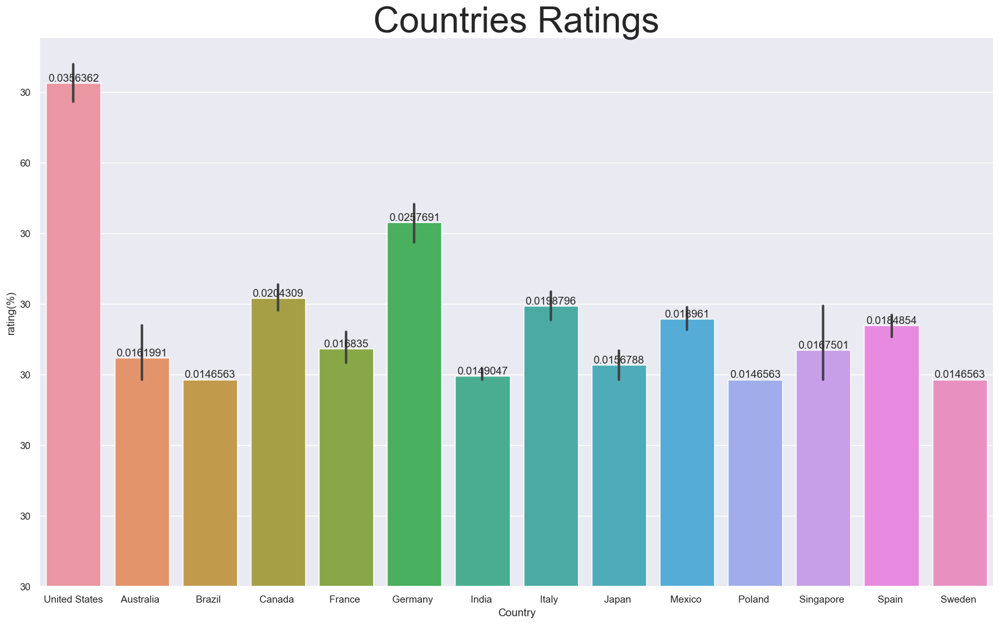

In [105]:
#plt.rcParams['figure.figsize'] = (19,11)
fig, ax = plt.subplots(figsize = (19,11))
plt.title('Countries Ratings',fontsize=40)
plt.ylabel('Countries')
plt.xlabel('Index')
ax.set_yticklabels(Rating.Rating_count)
label=sns.barplot(data=Rating,x='Country',y='rating(%)')
ax.bar_label(ax.containers[0])
plt.show()

<h2>Top 5 Star Rating</h2>

In [106]:
top5= amzRefined.groupby(['review_country'],['review_rating']==5.0)['review_rating'].count()
top5 =pd.DataFrame(top5)
top5=top5.reset_index(drop =False)

top5 = top5.nlargest(5,'review_rating')
top5['rating%']= (top5.review_rating/top5.review_rating.sum())*100

top5

,review_country,review_rating,rating%
0,United States,97380,53.414514
5,Germany,32070,17.590917
3,Canada,20910,11.469475
9,Mexico,16650,9.132796
7,Italy,15300,8.392299


[Text(0, 0.0, '97380'),
 Text(0, 10.0, '32070'),
 Text(0, 20.0, '20910'),
 Text(0, 30.0, '16650'),
 Text(0, 40.0, '15300'),
 Text(0, 50.0, ''),
 Text(0, 60.0, '')]

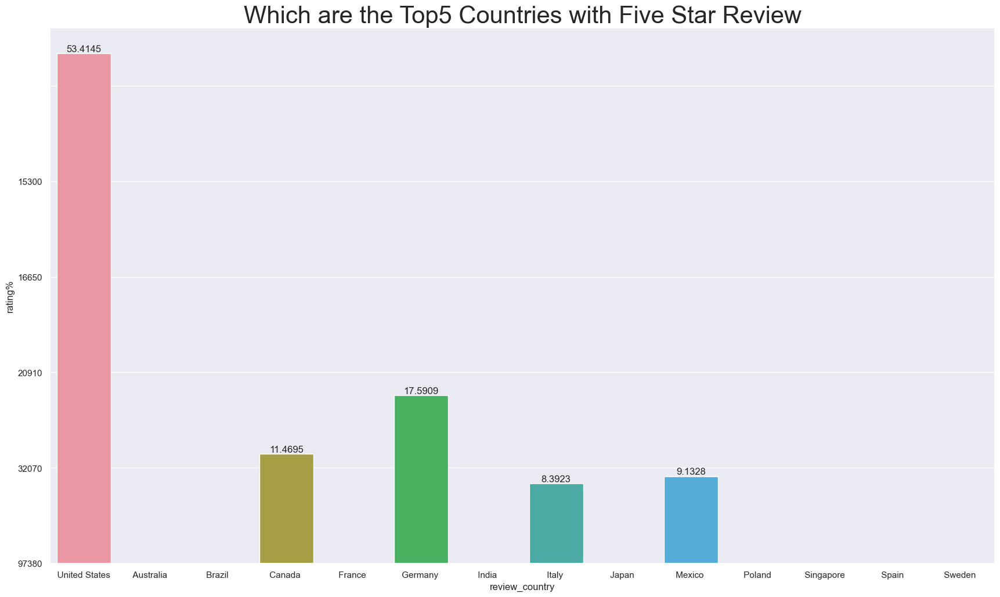

In [107]:
fig, ax = plt.subplots(figsize = (21,12))
plt.title('Which are the Top5 Countries with Five Star Review',fontsize=30)
plt.xlabel('Rating Count')
sns.barplot(data=top5,y='rating%',x='review_country')
ax.bar_label(ax.containers[0])
ax.set_yticklabels(top5['review_rating'])

<h2>One Star Rating</h2>

In [599]:
# 1Star Rating
one=amzRefined[amzRefined['review_rating']==1.0]
one=one.groupby('review_country',['verified_purchase']==1)['review_rating'].count()
one=one.reset_index(drop=False)
one = one
one['review_rating(%)'] = (one['review_rating']/one.review_rating.sum())*100

oneS= one.nlargest(5,'review_rating')
print(oneS ) 

       review_country  review_rating  review_rating(%)
0     United States            10440         53.211009
5           Germany             2580         13.149847
3            Canada             1890          9.633028
12            Spain             1410          7.186544
7             Italy             1110          5.657492


[Text(0, 0.0, '97380'),
 Text(0, 10.0, '32070'),
 Text(0, 20.0, '20910'),
 Text(0, 30.0, '16650'),
 Text(0, 40.0, '15300'),
 Text(0, 50.0, ''),
 Text(0, 60.0, '')]

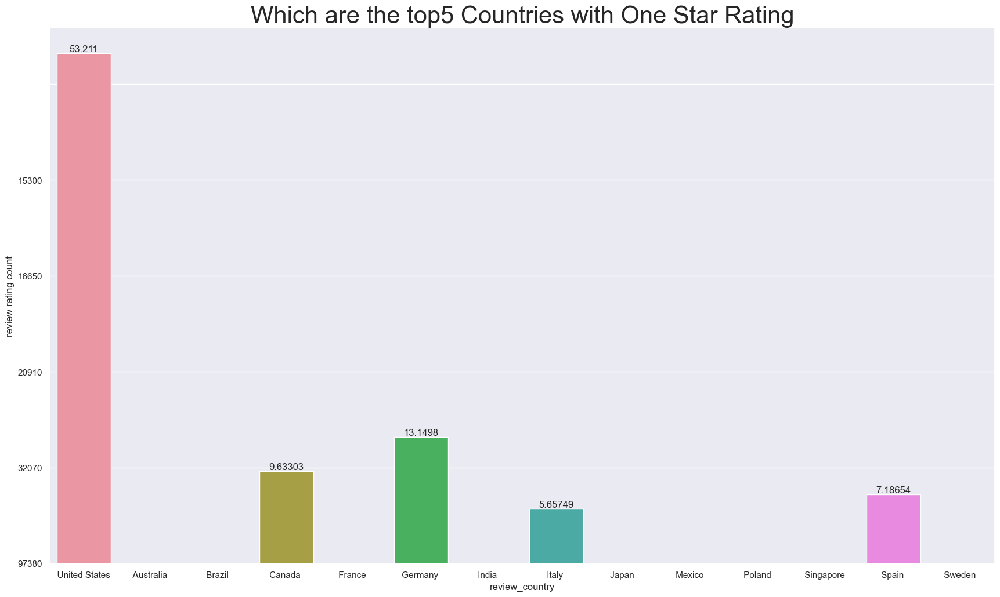

In [109]:

fig, ax = plt.subplots(figsize = (21,12))
plt.title('Which are the top5 Countries with One Star Rating',fontsize=30)
sns.barplot(data=oneS,y='review_rating(%)',x='review_country')
plt.ylabel('review rating count')
ax.bar_label(ax.containers[0])
ax.set_yticklabels(top5.review_rating)

One Star Rating

In [110]:
badr=amzRefined[amzRefined['review_rating']==1.0]
badr

,product_name,reviewer_name,review_title,review_text,review_rating,purchase_status,review_date,scraped_at,uniq_id,review_country,review
5,"GUESS Women's Bradly Gymnastics Shoe, White, 7 UK",Francesca,delusione,Sono solita comprare scarpe Guess e non ho mai...,1.0,Verified,2021-09-27,2021-12-24T02:26:25,6fe245b1-453e-59f4-bde8-b40eac3bddcd,Italy,1.0
22,"adidas Women's Retrorun Shoes Running, Core Bl...",B. Slate,NO SUPPORT! NOT FOR RUNNING!,I would NOT recommend these for running. They ...,1.0,Verified,2020-12-07,2021-12-24T02:26:25,1bd3f6f9-6e70-50a8-a913-6c9af4f8c7c7,United States,1.0
23,"Aravon Women's Betty-AR Oxfords, Stone, 5.5 UK",George-y,Not as supportive as I had hoped for.,These shoes are cute online but in person...no...,1.0,Verified,2016-10-05,2021-12-24T02:26:25,51b14655-18d6-556d-bf0b-1cbd9536d9a2,United States,1.0
34,Naturino Unisex Babies Cocoon First Walker Sho...,Szerda,Schmerzen am Kind...,"An sich wunderschöner Schuh, auspacken und dir...",1.0,Verified,2021-12-15,2021-12-24T02:26:25,34cf2187-d430-55c5-9ee9-29d680efa2a1,Germany,1.0
37,"Merrell Boys' Burnt Rock Low Sneaker, Black, 1...",Anna,Fell apart after one week,The laces broke after slightly over one week o...,1.0,Verified,2019-12-22,2021-12-24T02:26:25,c111f9c3-e95b-57c1-8a7f-879f9ec476df,United States,1.0
...,...,...,...,...,...,...,...,...,...,...,...
204601,"Skechers GO RUN TRAIL ALTITUDE, Men's Sneaker,...",Esmail m.,THIS SHOES DID NOT SATISFY ME,"SURPRISINGLY, AFTER 2 WEEKS OF JOGGING I NOTIC...",1.0,Verified,2021-07-10,2021-12-24T02:29:36,86c8adfa-63db-53ae-8f86-8440dd4d79ce,Canada,1.0
204616,SAGUARO Mens Womens Kids Lightweight Breathabl...,RealFrankyBoy,Poor quality neglected product!,I received the first time with manufacturing d...,1.0,Verified,2021-07-18,2021-12-24T02:29:37,156512f6-70d4-587e-961b-eec7ad07358f,Canada,1.0
204618,SAGUARO Mens Womens Kids Lightweight Breathabl...,Charles Frappier/Marcus Wells,Too large and warped,I was looking forward to these shoes for a sum...,1.0,Verified,2021-12-19,2021-12-24T02:29:37,4da4a7d9-d0eb-5c5d-ac8f-6119f2f52806,Canada,1.0
204645,New Balance Girl's Iconic 574 V1 Lace-Up Sneak...,Amazon Customer,I'm actually questioning the authenticity of t...,Sneakers do not come in a box and I'm actually...,1.0,Verified,2021-01-01,2021-12-24T02:29:38,7db75d8e-357c-582e-b8c8-4ca6b14d9247,United States,1.0


<h3>Top 10 Customers with the highest one star rating</h3>

In [111]:
a=amzRefined[amzRefined.review_rating==1.0]
a=a.groupby(by=['review_rating','reviewer_name','review_country'])['product_name'].count()
a=pd.DataFrame(a)          
a=a.reset_index()
a=a[a.product_name != 0]
a.rename(columns={'product_name':'product_count'},inplace=True)
a['product(%)'] = (a.product_count/a.product_count.sum())*100
a=a.nlargest(10,'product_count')
a

,review_rating,reviewer_name,review_country,product_count,product(%)
406,1.0,Amazon Customer,United States,930,4.740061
425,1.0,Amazon Kunde,Germany,210,1.070336
1566,1.0,Cliente Amazon,Spain,210,1.070336
409,1.0,Amazon Customer,Canada,150,0.764526
1561,1.0,Cliente Amazon,Italy,150,0.764526
1577,1.0,Cliente de Amazon,Mexico,90,0.458716
112,1.0,AY,United States,60,0.305810
483,1.0,Angelo Zoleo,Italy,60,0.305810
586,1.0,Antonio,Spain,60,0.305810
826,1.0,Barbara,United States,60,0.305810


<AxesSubplot:title={'center':'Top 10 1 star rating'}, xlabel='product(%)', ylabel='reviewer_name'>

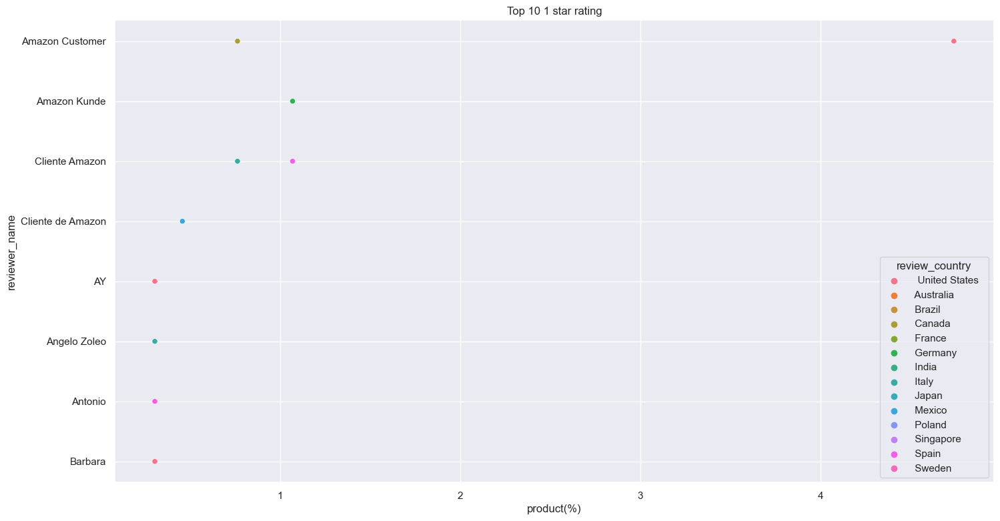

In [112]:
fig,ax=plt.subplots(figsize=(17,9))
plt.title('Top 10 1 star rating')
sns.scatterplot(data=a,y='reviewer_name',x='product(%)',hue='review_country')#,kind='swarm')#,hue='review_country')

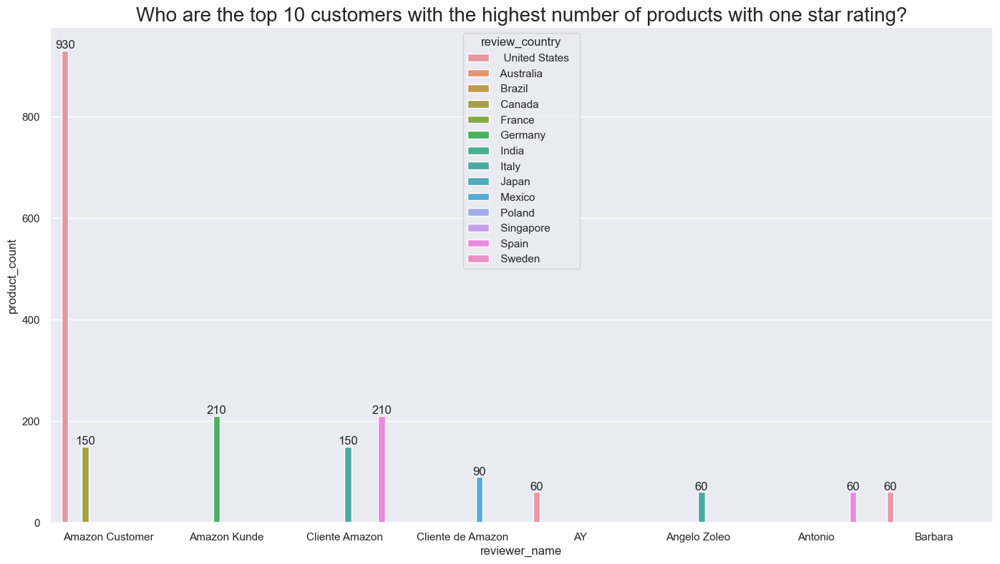

In [113]:
fig,ax=plt.subplots(figsize=(17,9))
plt.title('Who are the top 10 customers with the highest number of products with one star rating?',fontsize=20)
#ax.set_yticks(a['review_rating'])
sns.barplot(data=a,x='reviewer_name',y='product_count',hue='review_country')
for l in ax.containers:
    ax.bar_label(l)

<h3>Top 10 Customers with the have purchased the highest numbers of products that placed a 5 star review</h3>

In [114]:
lg=amzRefined[amzRefined.review_rating==5.0]
lg=lg.groupby(by=['review_rating','reviewer_name','review_country'])['product_name'].count()

lg=pd.DataFrame(lg)    

lg=lg.reset_index()
lg=lg[lg.product_name != 0]
lg.rename(columns={'product_name':'product_count'},inplace=True)
lg['product(%)'] = (lg.product_count/lg.product_count.sum())*100
lg=lg.nlargest(10,'product_count')
lg

,review_rating,reviewer_name,review_country,product_count,product(%)
197904,5.0,Amazon Customer,United States,3360,2.632197
197923,5.0,Amazon Kunde,Germany,2010,1.574618
197907,5.0,Amazon Customer,Canada,1710,1.339600
203861,5.0,Cliente Amazon,Italy,1650,1.292597
203866,5.0,Cliente Amazon,Spain,1260,0.987074
203947,5.0,Cliente de Amazon,Mexico,480,0.376028
203816,5.0,Client d'Amazon,France,390,0.305523
217868,5.0,Kindle Customer,United States,390,0.305523
197913,5.0,Amazon Customer,Mexico,180,0.141011
203815,5.0,Client d'Amazon,Canada,150,0.117509


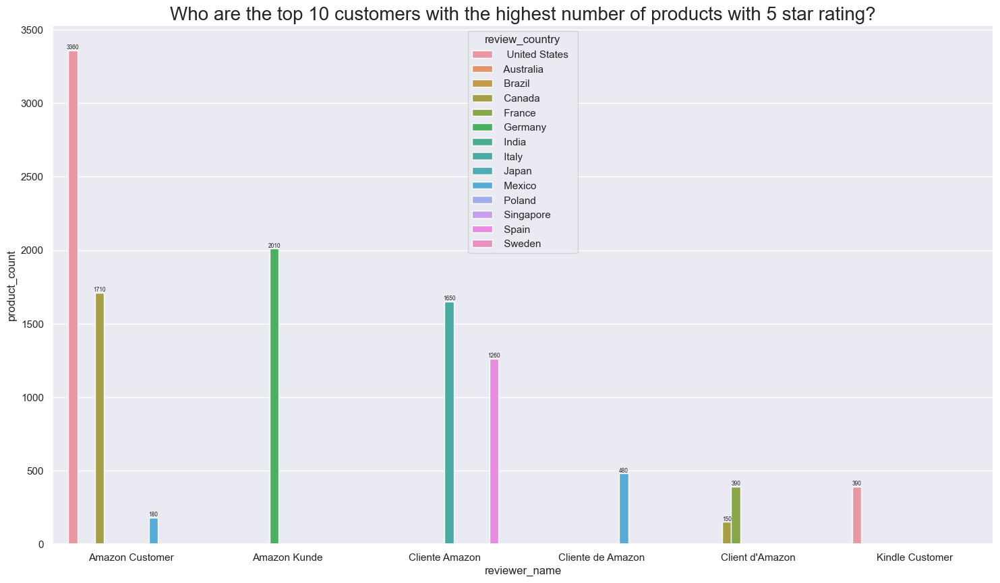

In [115]:
fig,ax=plt.subplots(figsize=(18,10))
plt.title('Who are the top 10 customers with the highest number of products with 5 star rating?',fontsize=20)
#ax.set_yticks(a['review_rating'])
sns.barplot(data=lg,x='reviewer_name',y='product_count',hue='review_country')
for l in ax.containers:
    ax.bar_label(l,fontsize=6)

In [116]:
amzRefined.review_date.min()

Timestamp('2010-04-22 00:00:00')

In [117]:
amzRefined.review_date.max()

Timestamp('2021-12-20 00:00:00')

<h3> On what type of products were rated 3.0 and below by Countries between 2019 and 2021?</h3> 

In [200]:
low=amzRefined[(amzRefined['review_date'] >= "2019-01-01") & (amzRefined['review_date'] < "2021-12-20")]
low=low[low.review <= 3.0]
low['product_count'] = low.product_name
low=low.groupby(by=['review_country','product_name','review'])['product_count'].count()
low.reset_index()
low = pd.DataFrame(low)
low =low[low['product_count'] != 0]
low['product(%)'] = (low.product_count/low.product_count.sum())*100
low

product_count  \
review_country    product_name                                       review                  
  United States   ALLY UNION MAKE FORCE Mens Womens Walking Shoes... 2.0                30   
                                                                     3.0                30   
                  ANNE KLEIN Women's Terri Sneaker, Grey Heathere... 1.0               120   
                  APEX LEGENDS Women's Breeze Athletic Knit Runni... 3.0                30   
                  ARIAT mens Midtown 11 UK                           3.0                60   
...                                                                                    ...   
 Spain            camel active Men's Bryce Sneaker, Navy Blue, 7.... 2.0                30   
                  victoria Unisex 106500-women Hi-Top Trainers, W... 2.0                30   
                                                                     3.0                30   
                  victoria Unisex Deportivo Laser Estrellas Train... 2.0                30   
                                                                     3.0                30   

                                                                             product(%)  
review_country    product_name                                       review              
  United States   ALLY UNION MAKE FORCE Mens Womens Walking Shoes... 2.0       0.067843  
                                                                     3.0       0.067843  
                  ANNE KLEIN Women's Terri Sneaker, Grey Heathere... 1.0       0.271370  
                  APEX LEGENDS Women's Breeze Athletic Knit Runni... 3.0       0.067843  
                  ARIAT mens Midtown 11 UK                           3.0       0.135685  
...                                                                                 ...  
 Spain            camel active Men's Bryce Sneaker, Navy Blue, 7.... 2.0       0.067843  
                  victoria Unisex 106500-women Hi-Top Trainers, W... 2.0       0.067843  
                                                                     3.0       0.067843  
                  victoria Unisex Deportivo Laser Estrellas Train... 2.0       0.067843  
                                                                     3.0       0.067843  

[1143 rows x 2 columns]

<h3> Top 10 3.0 and below rating between 2019 and 2021</h3>

In [203]:
top_ten = low.nlargest(10,'product_count')
top_ten

product_count  \
review_country    product_name                                       review                  
  United States   Brooks Womens Range Running Shoe - Oyster Mushr... 3.0               150   
                  Saucony Kids&#39; Astrofoam Sneaker                1.0               150   
 Germany          Lico Fremont Cross Country Running Shoe, Marine... 1.0               150   
  United States   ANNE KLEIN Women's Terri Sneaker, Grey Heathere... 1.0               120   
                  New Balance Men's 950V3 Mid-Cut Baseball Shoe, ... 3.0               120   
                  Steve Madden Women's Myles Sneaker, Grey Mesh, ... 3.0               120   
                  adidas Originals Women's Coast Star W Sneaker, ... 1.0               120   
 Canada           Mizuno Women's Wave Creation 20 Running Shoe, S... 1.0               120   
                  SAGUARO Mens Womens Kids Lightweight Breathable... 3.0               120   
 Germany          CREPUSCOLO Men's Moccasins Slip-On Loafers Snea... 1.0               120   

                                                                             product(%)  
review_country    product_name                                       review              
  United States   Brooks Womens Range Running Shoe - Oyster Mushr... 3.0       0.339213  
                  Saucony Kids&#39; Astrofoam Sneaker                1.0       0.339213  
 Germany          Lico Fremont Cross Country Running Shoe, Marine... 1.0       0.339213  
  United States   ANNE KLEIN Women's Terri Sneaker, Grey Heathere... 1.0       0.271370  
                  New Balance Men's 950V3 Mid-Cut Baseball Shoe, ... 3.0       0.271370  
                  Steve Madden Women's Myles Sneaker, Grey Mesh, ... 3.0       0.271370  
                  adidas Originals Women's Coast Star W Sneaker, ... 1.0       0.271370  
 Canada           Mizuno Women's Wave Creation 20 Running Shoe, S... 1.0       0.271370  
                  SAGUARO Mens Womens Kids Lightweight Breathable... 3.0       0.271370  
 Germany          CREPUSCOLO Men's Moccasins Slip-On Loafers Snea... 1.0       0.271370

<Figure size 1900x1100 with 0 Axes>

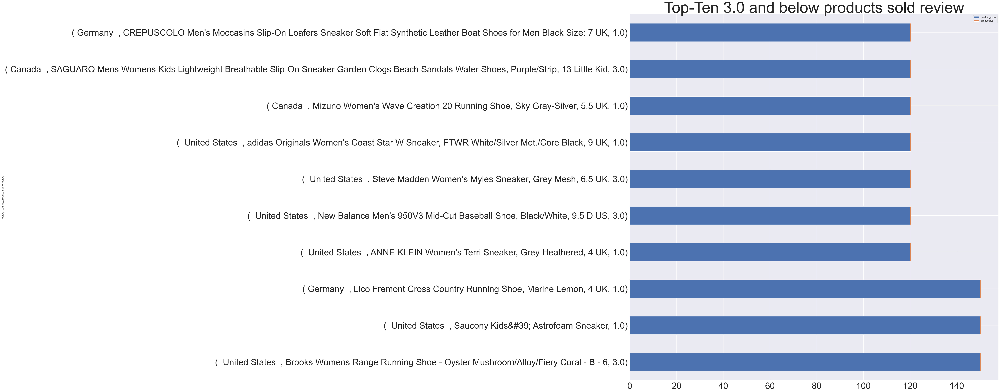

In [270]:
plt.figure()
plt.rcParams.update({'font.size' :20})
top_ten.plot(kind='barh',figsize=(30,30),stacked=True,fontsize=40,legend =True)
plt.title("Top-Ten 3.0 and below products sold review",fontsize=70)
plt.show(block=True)

<h3>Our Major Customers</h3>

In [286]:
_5star=amzRefined.groupby('reviewer_name',['review_rating']==5.0)['review_country'].value_counts().sort_values(ascending = False)
_5star=_5star.head(5)

#plt.xticks(rotation = 45)
_5star = pd.DataFrame(_5star) 
_5star.rename(columns = {'review_country':'rating_proportion(%)'}, inplace = True)

_5star['rating_proportion(%)'] = (_5star['rating_proportion(%)']/_5star['rating_proportion(%)'].sum())*100
_5star.nlargest(5,'rating_proportion(%)')

rating_proportion(%)
reviewer_name                                          
Amazon Customer   United States               41.523810
Amazon Kunde     Germany                      18.476190
Amazon Customer  Canada                       15.047619
Cliente Amazon   Italy                        13.714286
                 Spain                        11.238095

<Figure size 1900x1100 with 0 Axes>

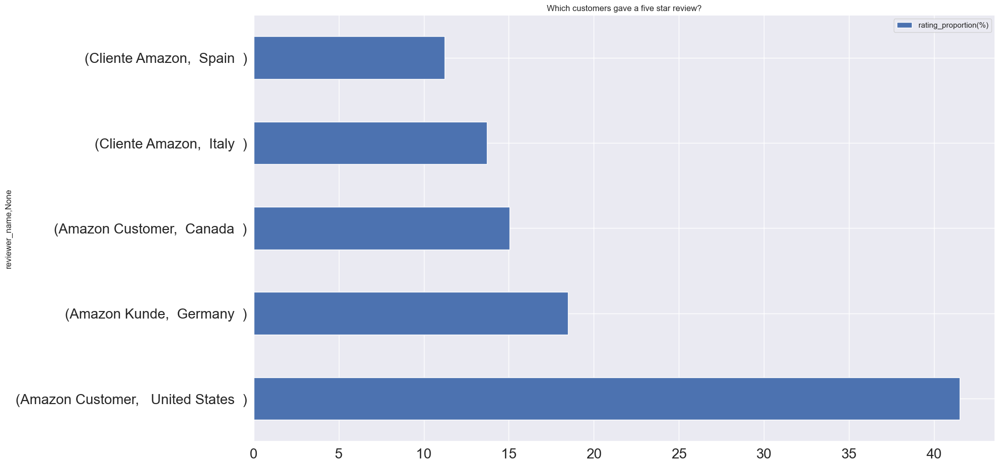

In [287]:
plt.figure()
plt.rcParams.update({'font.size' :20})

_5star.plot(kind='barh',title = 'Which customers gave a five star review?',fontsize=20 )
plt.show(block=True)

# STEP 8: UNDERSTANDING TREND

<h2>Time Series</h2>

In [288]:
trend = amzRefined.groupby('review_date').median()
trend

,review
review_date,
2010-04-22,5.0
2010-05-09,5.0
2010-08-18,5.0
2010-09-17,5.0
2011-03-10,5.0
...,...
2021-12-16,5.0
2021-12-17,5.0
2021-12-18,5.0


Text(0, 0.5, 'mean of rating')

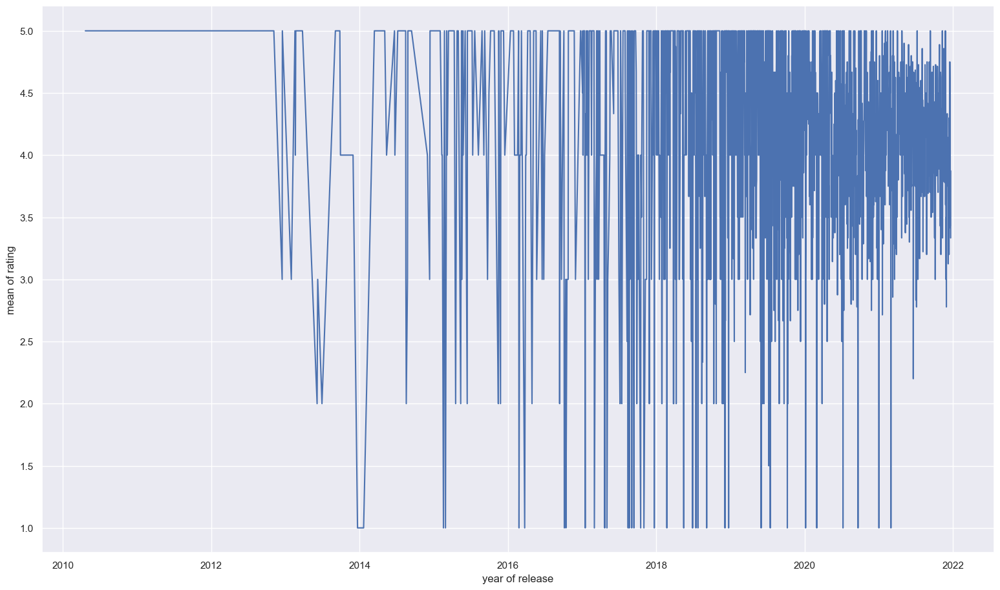

In [289]:
plt.rcParams['figure.figsize'] = (19,11)
plt.plot(trend.index,amzRefined.groupby('review_date')['review'].agg(np.mean))
plt.xlabel('year of release')
plt.ylabel('mean of rating')


Visualising seasonality,trend and noisy kindness

<Figure size 4000x1600 with 0 Axes>

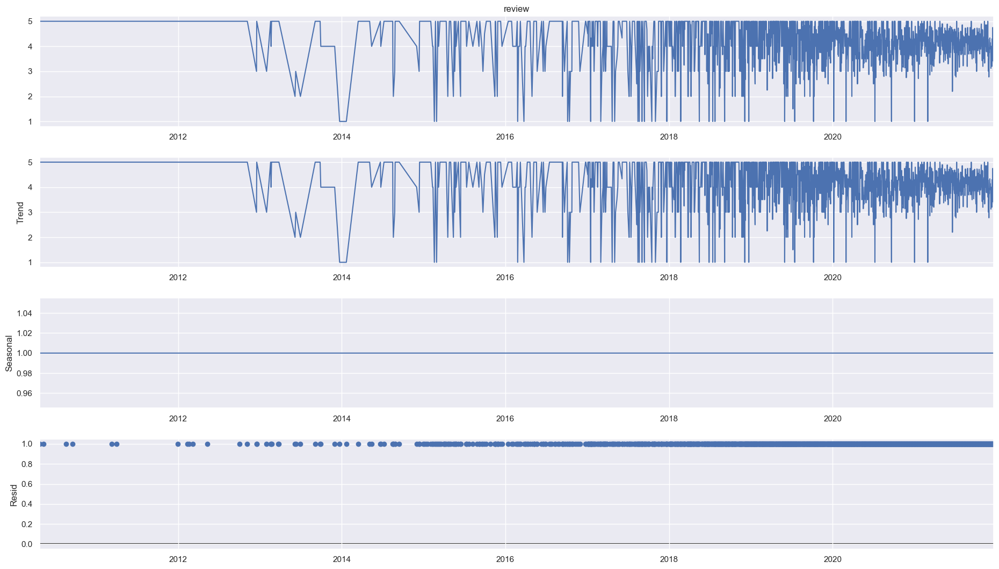

In [291]:
from statsmodels.tsa.seasonal import seasonal_decompose
# To visualize the seanality & trendy & noisy kindness we utilize the seasonal_decompose()

plt.figure(num=None, figsize=(50, 20), dpi=80, facecolor='w', edgecolor='k')
result=seasonal_decompose(amzRefined.groupby('review_date')['review'].agg(np.mean), model='multiplicative', period=1)
result_plot=result.plot()

In [292]:
season=amzRefined[['review_date','review']]

Set the index as datetime and select column for analysis

In [293]:
season = season.set_index('review_date')

In [294]:
season

,review
review_date,
2020-02-06,5.0
2021-10-28,2.0
2021-01-20,5.0
2021-04-22,5.0
2021-02-04,5.0
...,...
2020-10-15,5.0
2020-08-23,5.0
2021-04-10,5.0


<h3>what is the rating proportion on monthly basis?</h3>

Let us understand it

In [296]:
monthly=season.review.resample('M').mean().ffill()
m=pd.DataFrame(monthly)
m

,review
review_date,
2010-04-30,5.000000
2010-05-31,5.000000
2010-06-30,5.000000
2010-07-31,5.000000
2010-08-31,5.000000
...,...
2021-08-31,4.206767
2021-09-30,4.158451
2021-10-31,4.150350


<AxesSubplot:xlabel='review_date'>

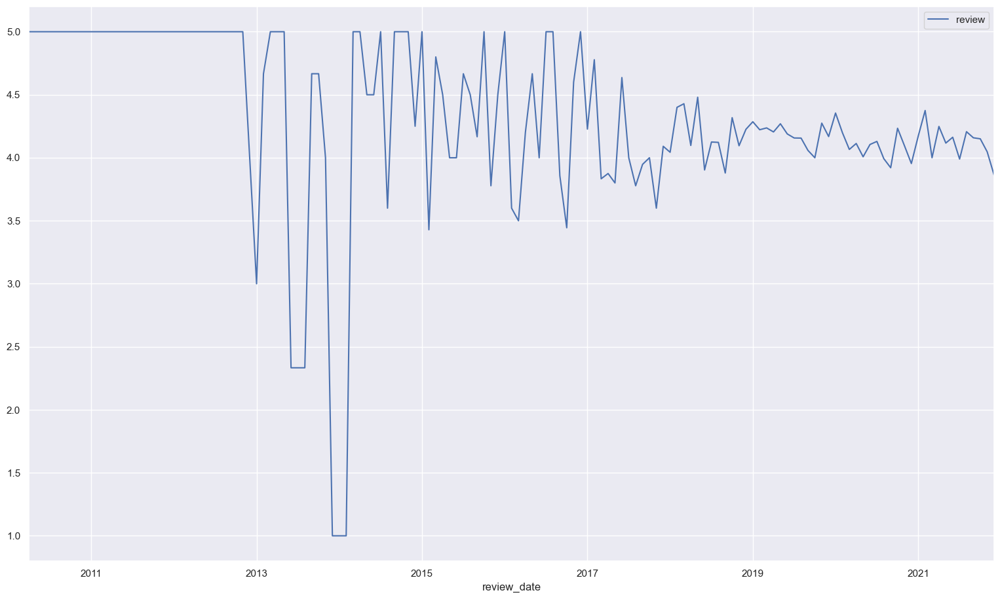

In [297]:

m.plot()

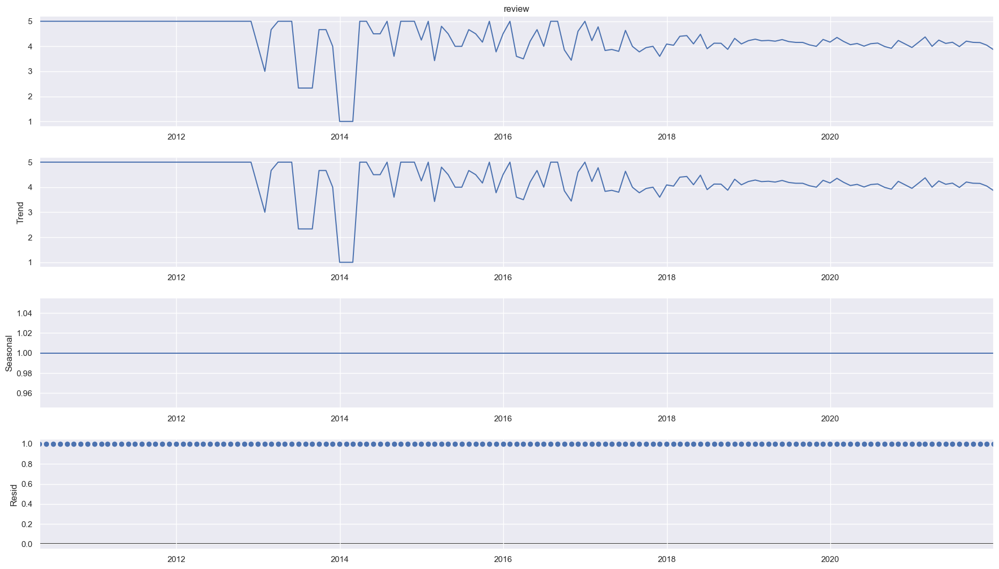

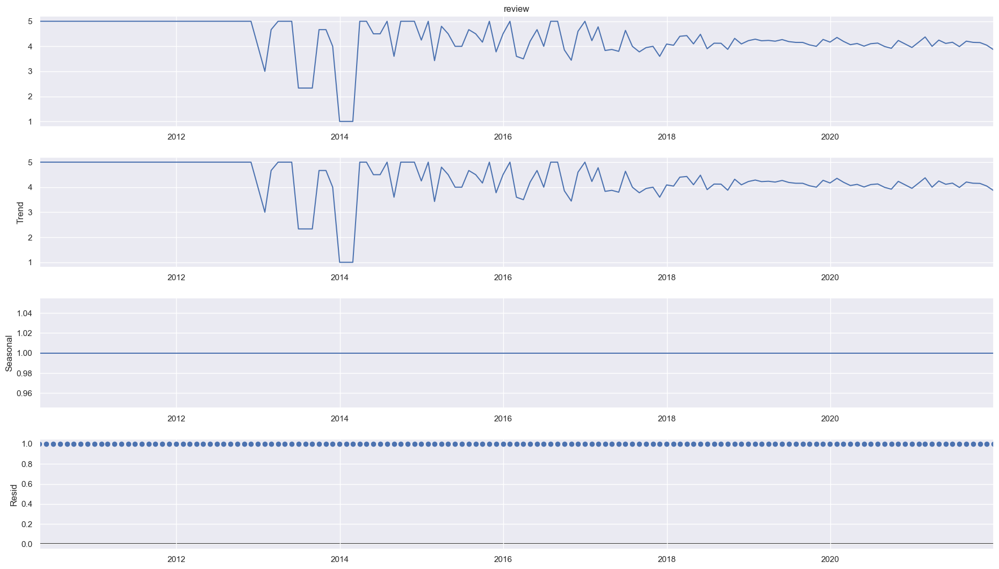

In [299]:
mon = seasonal_decompose(m.review,period=1,model='multiplicative')
one_month = mon
one_month.plot()

<h3>Trend Analysis</h3>

From 2012 to 2013, there was a conatant trend wheres from the begining of 2014 to 2015 there was up and downward trend.
In 2014 rating dropped drastically.The shows that the company recorded poor sales in that period. The company need to know the aspect it need improvement

Text(0.5, 1.0, 'Rating on Monthly Basis for the years')

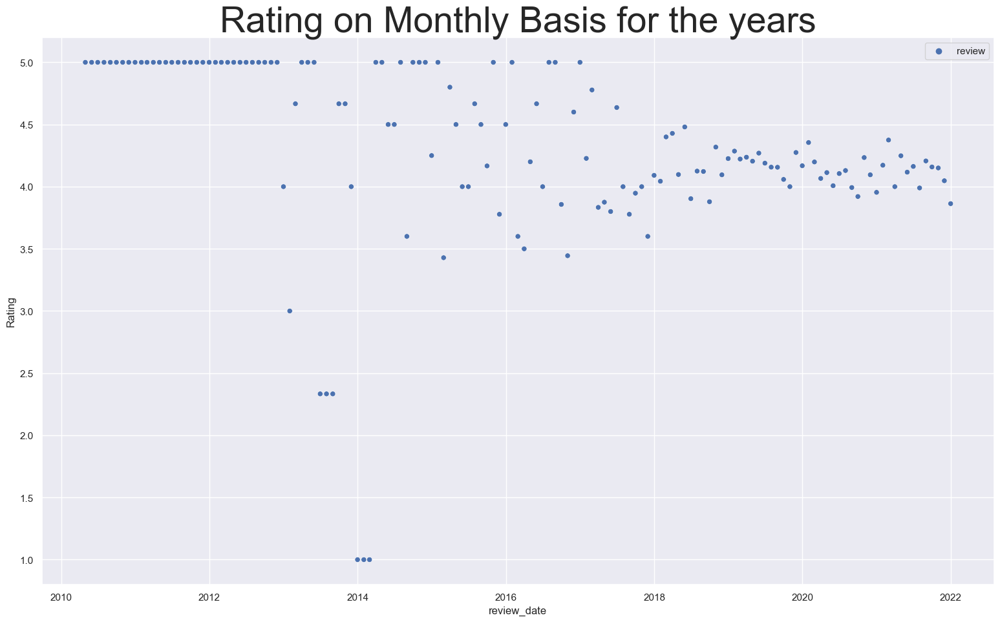

In [304]:
sns.scatterplot(data=m)
plt.ylabel('Rating')
plt.title('Rating on Monthly Basis for the years',fontsize=40)

Text(0.5, 1.0, 'Monthly Rating')

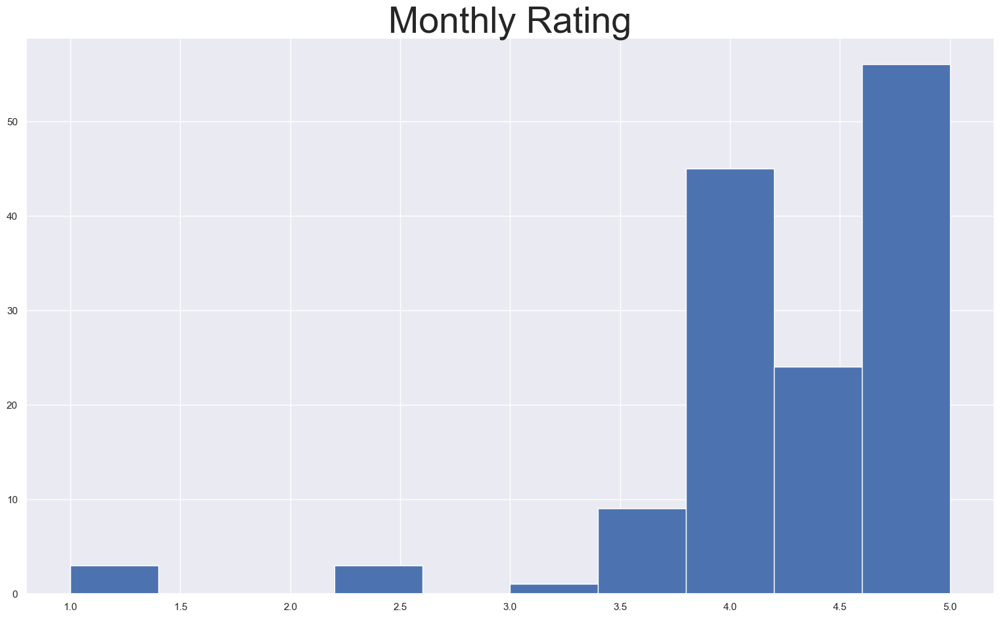

In [305]:
m.hist()
plt.title('Monthly Rating',fontsize=40)

Monthly Average Rating

In [306]:
mv=m/m.sum()*100
mv

,review
review_date,
2010-04-30,0.821521
2010-05-31,0.821521
2010-06-30,0.821521
2010-07-31,0.821521
2010-08-31,0.821521
...,...
2021-08-31,0.691190
2021-09-30,0.683251
2021-10-31,0.681920


Text(0.5, 1.0, 'Monthly Average')

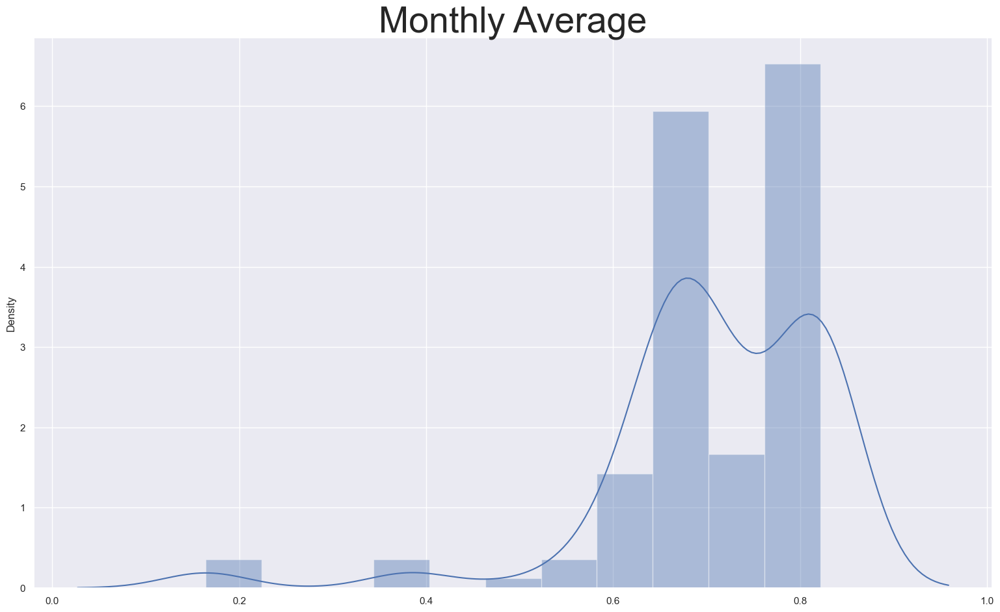

In [307]:
sns.distplot(mv)
plt.title('Monthly Average',fontsize=40)

See the spread

Text(24.444444444444443, 0.5, 'Rating')

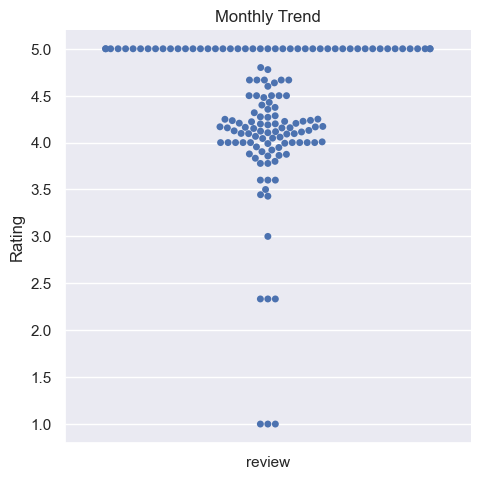

In [310]:
sns.catplot(data=m,kind='swarm')
plt.title('Monthly Trend')
plt.ylabel('Rating')

<h3>Decompose to understand trend, seasonality and noise</h3>

<H3> Understanding Weekly Trends</H3>

In [311]:
wk= m
wk = wk.resample('w').mean().interpolate()
wk

,review
review_date,
2010-05-02,5.000000
2010-05-09,5.000000
2010-05-16,5.000000
2010-05-23,5.000000
2010-05-30,5.000000
...,...
2021-12-05,4.047431
2021-12-12,4.001412
2021-12-19,3.955392


In [313]:
wk_avg = (wk.review/wk.review.sum())*100
wk_avg

review_date
2010-05-02    0.189970
2010-05-09    0.189970
2010-05-16    0.189970
2010-05-23    0.189970
2010-05-30    0.189970
                ...   
2021-12-05    0.153778
2021-12-12    0.152030
2021-12-19    0.150281
2021-12-26    0.148533
2022-01-02    0.146784
Freq: W-SUN, Name: review, Length: 610, dtype: float64

Text(0.5, 1.0, 'weekly average')

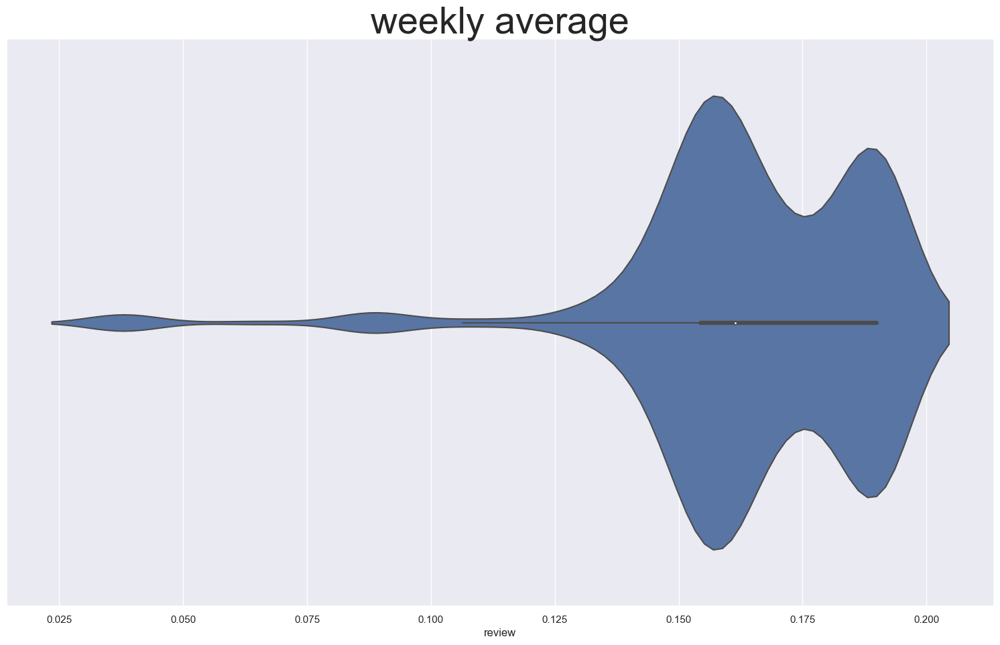

In [314]:
sns.violinplot(wk_avg)
plt.title('weekly average',fontsize=40)

Text(0.5, 1.0, 'Weekly Rating Trend')

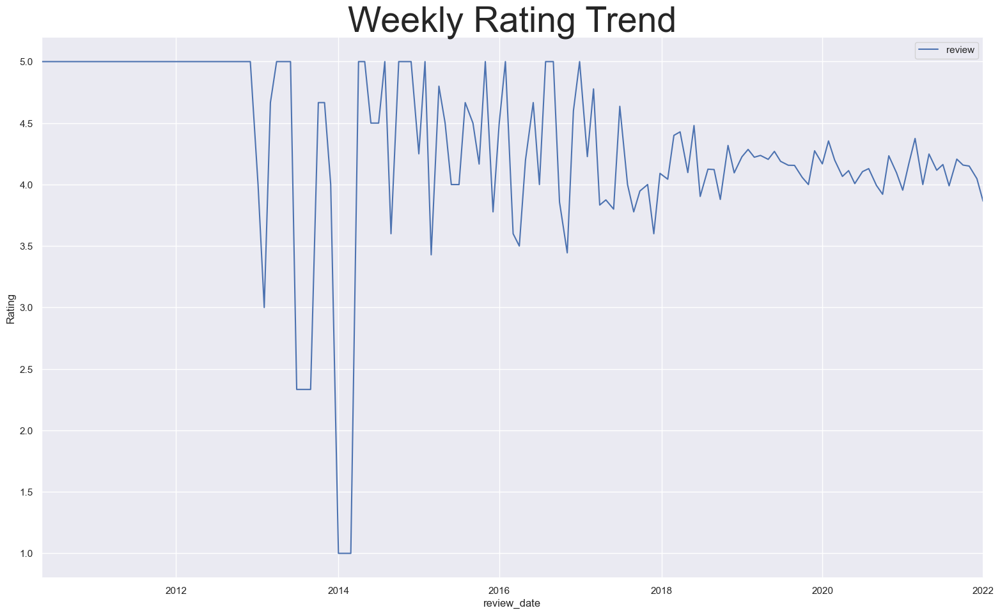

In [315]:
wk.plot()
plt.ylabel('Rating')
plt.title('Weekly Rating Trend',fontsize=40)

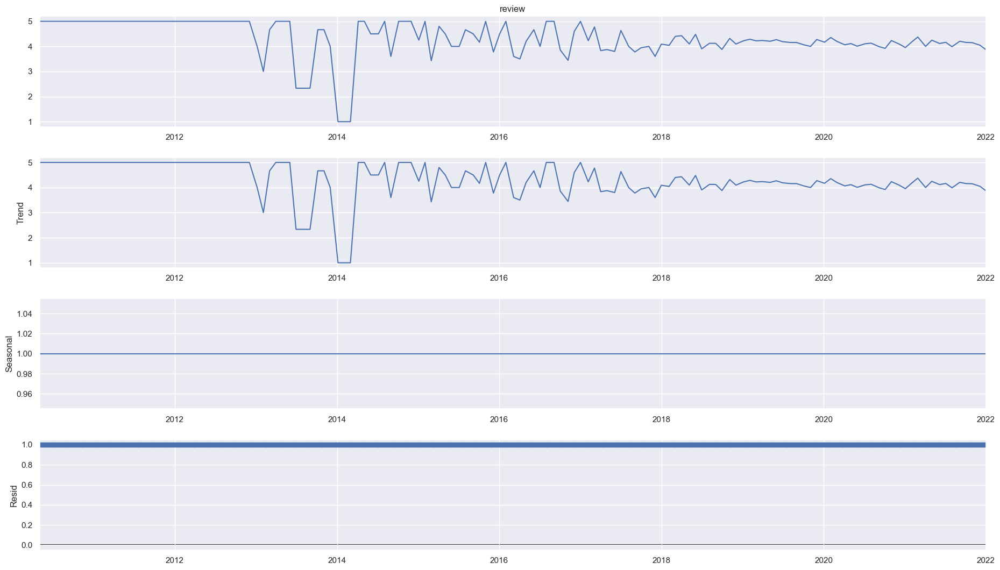

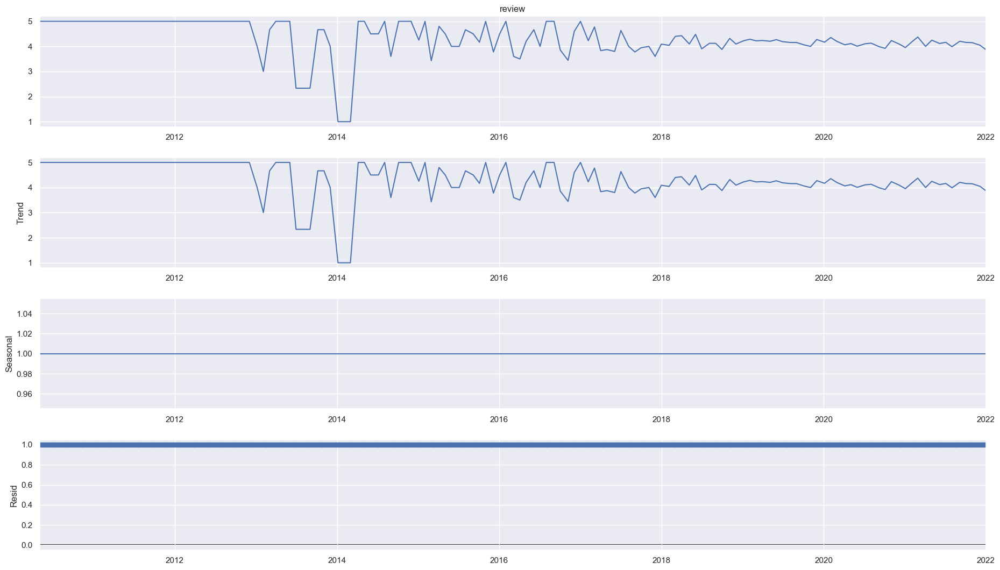

In [317]:
w =seasonal_decompose(wk.review,model='multiplicative',period=1)
w.plot()

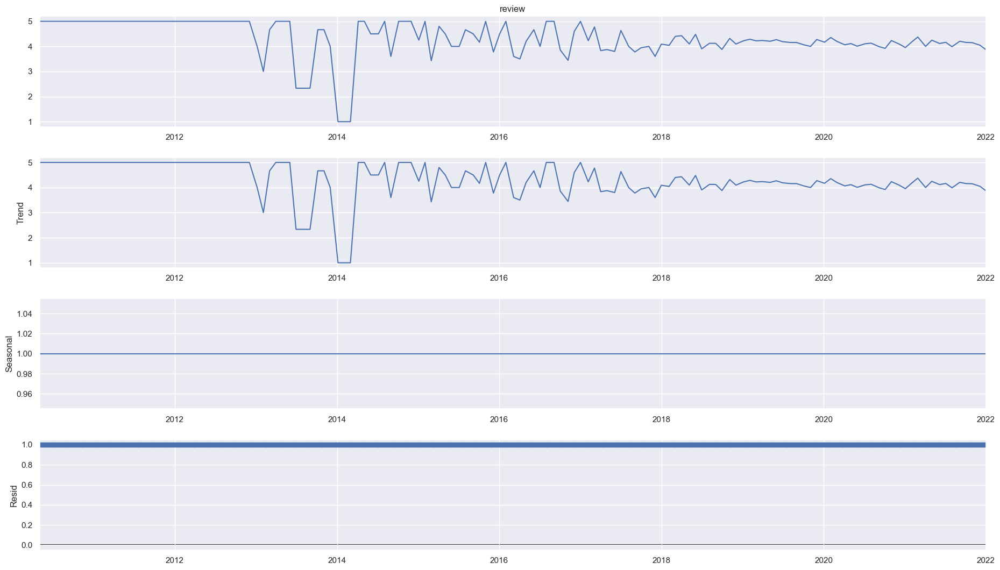

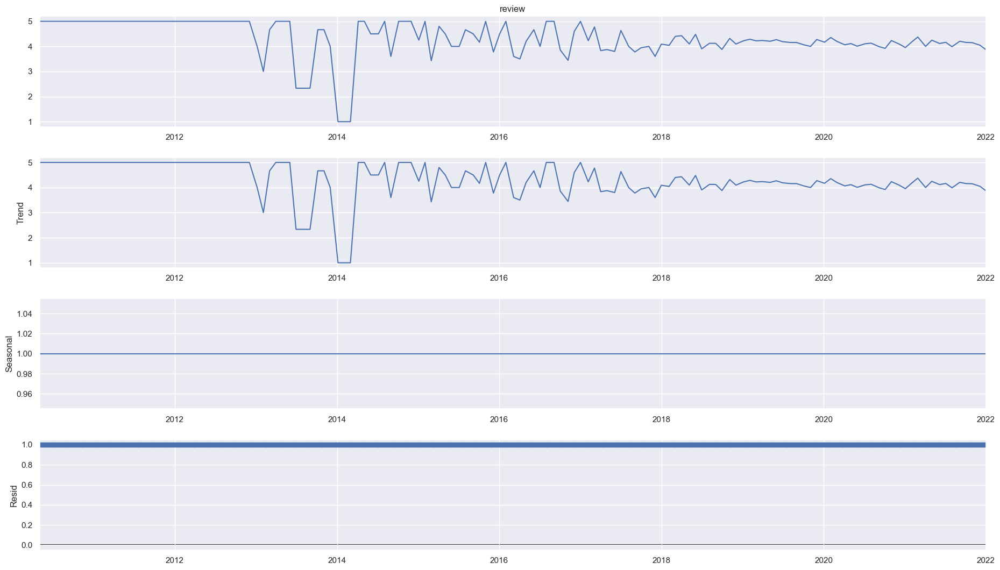

In [318]:
w.plot()

# Step 9: Understanding relationship

What is the relationship between product and customer rating?

What is their reaction after utilizing the product based on their review?

If the product is good or bad, what are their rating?

In [319]:
import scipy.stats
from scipy.stats import chi2

ct_table_ind=pd.crosstab(amzRefined["product_name"],amzRefined["review_rating"])
print('contingency_table :\n',ct_table_ind)


contingency_table :
 review_rating                                       1.0  2.0  3.0  4.0  5.0
product_name                                                               
': 'ZAPATILLA NEW BALANCE KV220, Navy/White, 9....   30   30    0   60  180
ACE Constructor High S3 Work Boots - Mens Leath...   30   30   60   60  120
ALLY UNION MAKE FORCE Mens Womens Walking Shoes...    0   30   30   60  180
ANNE KLEIN Women's Anne Kleon Onthego Sneaker, ...    0    0    0   30    0
ANNE KLEIN Women's Terri Sneaker, Grey Heathere...  120    0   30    0  150
...                                                 ...  ...  ...  ...  ...
victoria Unisex 106500-women Hi-Top Trainers, W...    0   30   30  150   90
victoria Unisex Adults JUEGOS Slip ON LONA Mult...    0    0    0    0   60
victoria Unisex Deportivo Laser Estrellas Train...    0   30   30    0   90
victoria Unisex Kids Deportivo Lurex Trainers, ...   30    0    0   30  120
victoria Women's Basket Terciopelo Trainers, Gr...    0    0    0  

In [320]:
chi2_stat, p, dof, expected = scipy.stats.chi2_contingency(ct_table_ind)
 
print(f"chi2 statistic:     {chi2_stat:.5g}")
print(f"p-value:            {p:.5g}")
print(f"degrees of freedom: {dof}")
print("expected frequencies:\n",expected)

chi2 statistic:     1.4815e+05
p-value:            0
degrees of freedom: 4340
expected frequencies:
 [[ 28.75567932  17.23582002  26.60120182  40.31950755 187.08779129]
 [ 28.75567932  17.23582002  26.60120182  40.31950755 187.08779129]
 [ 28.75567932  17.23582002  26.60120182  40.31950755 187.08779129]
 ...
 [ 14.37783966   8.61791001  13.30060091  20.15975377  93.54389565]
 [ 17.25340759  10.34149201  15.96072109  24.19170453 112.25267478]
 [  2.87556793   1.723582     2.66012018   4.03195075  18.70877913]]


In [321]:

cot_table_ind=pd.crosstab(amzRefined["review_country"],amzRefined["product_name"])
print('contingency_table :\n',cot_table_ind)

contingency_table :
 product_name       ': 'ZAPATILLA NEW BALANCE KV220, Navy/White, 9.5 UK Child  \
review_country                                                                 
  United States                                                  240           
 Australia                                                         0           
 Brazil                                                            0           
 Canada                                                            0           
 France                                                           30           
 Germany                                                           0           
 India                                                             0           
 Italy                                                             0           
 Japan                                                             0           
 Mexico                                                            0           
 Poland            

In [322]:
chi2_stats, pvalue, d_o_f, expected_value = scipy.stats.chi2_contingency(cot_table_ind)
 
print(f"chi2 statistic:     {chi2_stats:.5g}")
print(f"p-value:            {pvalue:.5g}")
print(f"degrees of freedom: {d_o_f}")
print("expected frequencies")

chi2 statistic:     1.2745e+06
p-value:            0
degrees of freedom: 14105
expected frequencies


<h3>What is the relationship between customers and their rating</h3>

<h4>What is the feedback of customers upon product utility?</h4>

<h4>Let us conduct the f_oneway test to check.</h3>

In [327]:
# f_oneway() function takes the group data as input and
# returns F-statistic and P-value
from scipy.stats import f_oneway
 
# Running the one-way anova test between  customers and their rating
# Assumption(H0) is that reviewer_name and reviewer_rating are NOT correlated
 
# Finds out the rating data for each country as a list
CategoryGroupLists=amzRefined.groupby('review_country')['review'].apply(list)
 
# Performing the ANOVA test
# We accept the Assumption(H0) only when P-Value &gt; 0.05
AnovaResults = f_oneway(*CategoryGroupLists)
print('P-Value for Anova is: ', AnovaResults[1],'\nHence we reject the null hypothesis since there is relationship between the two variables')

P-Value for Anova is:  0.0 
Hence we reject the null hypothesis since there is relationship between the two variables


In [328]:
amztok = amzRefined

# Step 9: Sentiment Analysis

Cleaning the texture data

In [332]:
#!pip install NLTK
import nltk
from nltk.tokenize import RegexpTokenizer

Change strings to lowercase

In [330]:
amztok['review_text'] = amztok['review_text'].astype(str).str.lower()

Group words and apply the regexp tokenizer to review_text column

In [331]:
regexp = RegexpTokenizer('\w+')
amztok['text_token']=amztok['review_text'].apply(regexp.tokenize)
amztok.head(3)

,product_name,reviewer_name,review_title,review_text,review_rating,purchase_status,review_date,scraped_at,uniq_id,review_country,review,text_token
0,Klasified Women's Transparent Clear Sneaker Sh...,Jocelyn McSayles,Love em,love these. was looking for converses and thes...,5.0,Verified,2020-02-06,2021-12-24T02:26:25,36eae4e5-2894-5279-a0b7-d2b330e2b814,United States,5.0,"[love, these, was, looking, for, converses, an..."
1,Klasified Women's Transparent Clear Sneaker Sh...,Kenia Rivera,The plastic ripped,"the shoes are very cute, but after the 2nd day...",2.0,Verified,2021-10-28,2021-12-24T02:26:25,f4778bb8-3070-5cb1-b5aa-ffce41a97b57,United States,2.0,"[the, shoes, are, very, cute, but, after, the,..."
2,Klasified Women's Transparent Clear Sneaker Sh...,Chris Souza,Good quality,good quality,5.0,Verified,2021-01-20,2021-12-24T02:26:25,db5a7525-d40b-5265-84d8-df4f29837a3b,United States,5.0,"[good, quality]"


Download stop words from bag of stop words

In [333]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.


True

Make a list of stopwords in english

In [334]:
from nltk.corpus import stopwords

# Make a list of english stopwords
stopwords = nltk.corpus.stopwords.words("english")


In [335]:

# Extend the list with your own custom stopwords
jo_stopwords = ['https']
stopwords.extend(jo_stopwords)

In [336]:
# Remove stopwords
amztok['text_token'] = amztok['text_token'].apply(lambda x: [item for item in x if item not in stopwords])

In [337]:
amztok.text_token.head(3)

0    [love, looking, converses, half, price, unique...
1    [shoes, cute, 2nd, day, wearing, tongue, start...
2                                      [good, quality]
Name: text_token, dtype: object

Remove infrequent words

In [338]:
amztok['text_string'] = amztok['text_token'].apply(lambda x: ' '.join([item for item in x if len(item)>2]))

In [339]:
amztok[['review_text', 'text_token', 'text_string']].head()

,review_text,text_token,text_string
0,love these. was looking for converses and thes...,"[love, looking, converses, half, price, unique...",love looking converses half price unique never...
1,"the shoes are very cute, but after the 2nd day...","[shoes, cute, 2nd, day, wearing, tongue, start...",shoes cute 2nd day wearing tongue started ripp...
2,good quality,"[good, quality]",good quality
3,great,[great],great
4,ho scelto il modello bianco con rifinitura die...,"[ho, scelto, il, modello, bianco, con, rifinit...",scelto modello bianco con rifinitura dietro ne...


In [340]:
#Create a list of all words
all_words = ' '.join([word for word in amztok['text_string']])

In [341]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping tokenizers\punkt.zip.


True

In [342]:
#Tokenize all_words
tokenized_words = nltk.tokenize.word_tokenize(all_words)

In [343]:
#Create a frequency distribution which records the number of times each word has occurred:

from nltk.probability import FreqDist

fdist = FreqDist(tokenized_words)
display(fdist)

FreqDist({'shoes': 77520, 'shoe': 48090, 'size': 45420, 'comfortable': 34980, 'fit': 33330, 'und': 29520, 'great': 29430, 'like': 26970, 'die': 25290, 'feet': 24720, ...})

Now we can use our fdist dictionary to drop words which occur less than a certain amount of times (usually we use a value of 3 or 4), depending our dataset.

In [344]:
amztok['text_string_fdist'] = amztok['text_token'].apply(lambda x: ' '.join([item for item in x if fdist[item] >= 1 ]))

In [345]:
amztok[['review_text', 'text_token', 'text_string', 'text_string_fdist']].head()

,review_text,text_token,text_string,text_string_fdist
0,love these. was looking for converses and thes...,"[love, looking, converses, half, price, unique...",love looking converses half price unique never...,love looking converses half price unique never...
1,"the shoes are very cute, but after the 2nd day...","[shoes, cute, 2nd, day, wearing, tongue, start...",shoes cute 2nd day wearing tongue started ripp...,shoes cute 2nd day wearing tongue started ripp...
2,good quality,"[good, quality]",good quality,good quality
3,great,[great],great,great
4,ho scelto il modello bianco con rifinitura die...,"[ho, scelto, il, modello, bianco, con, rifinit...",scelto modello bianco con rifinitura dietro ne...,scelto modello bianco con rifinitura dietro ne...


<h2>Lemmatization</h2>
<h3>Next, we perfom lemmatization.</h3>

In [346]:
#Lemmatization
#Next, we perfom lemmatization.
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...


True

In [347]:
from nltk.stem import WordNetLemmatizer

wordnet_lem = WordNetLemmatizer()

amztok['text_string_lem'] = amztok['text_string_fdist'].apply(wordnet_lem.lemmatize)

Check for columns equality

In [349]:
# check if the columns are equal
amztok['is_equal']= (amztok['text_string_fdist']==amztok['text_string_lem'])

In [350]:
# show level count
amztok.is_equal.value_counts()

True     204510
False       180
Name: is_equal, dtype: int64

In [351]:
amztok.head(5)

,product_name,reviewer_name,review_title,review_text,review_rating,purchase_status,review_date,scraped_at,uniq_id,review_country,review,text_token,text_string,text_string_fdist,text_string_lem,is_equal
0,Klasified Women's Transparent Clear Sneaker Sh...,Jocelyn McSayles,Love em,love these. was looking for converses and thes...,5.0,Verified,2020-02-06,2021-12-24T02:26:25,36eae4e5-2894-5279-a0b7-d2b330e2b814,United States,5.0,"[love, looking, converses, half, price, unique...",love looking converses half price unique never...,love looking converses half price unique never...,love looking converses half price unique never...,True
1,Klasified Women's Transparent Clear Sneaker Sh...,Kenia Rivera,The plastic ripped,"the shoes are very cute, but after the 2nd day...",2.0,Verified,2021-10-28,2021-12-24T02:26:25,f4778bb8-3070-5cb1-b5aa-ffce41a97b57,United States,2.0,"[shoes, cute, 2nd, day, wearing, tongue, start...",shoes cute 2nd day wearing tongue started ripp...,shoes cute 2nd day wearing tongue started ripp...,shoes cute 2nd day wearing tongue started ripp...,True
2,Klasified Women's Transparent Clear Sneaker Sh...,Chris Souza,Good quality,good quality,5.0,Verified,2021-01-20,2021-12-24T02:26:25,db5a7525-d40b-5265-84d8-df4f29837a3b,United States,5.0,"[good, quality]",good quality,good quality,good quality,True
3,Klasified Women's Transparent Clear Sneaker Sh...,Amazon Customer,Good,great,5.0,Verified,2021-04-22,2021-12-24T02:26:25,75a42851-6462-54b5-988a-27d336221943,United States,5.0,[great],great,great,great,True
4,"GUESS Women's Bradly Gymnastics Shoe, White, 7 UK",Graziella,PERFETTE!!,ho scelto il modello bianco con rifinitura die...,5.0,Verified,2021-02-04,2021-12-24T02:26:25,232dee43-849e-5d06-ba05-efb3f4814714,Italy,5.0,"[ho, scelto, il, modello, bianco, con, rifinit...",scelto modello bianco con rifinitura dietro ne...,scelto modello bianco con rifinitura dietro ne...,scelto modello bianco con rifinitura dietro ne...,True


# Word cloud

In [359]:
all_words_lem = ' '.join([word for word in amztok['text_string_lem']])

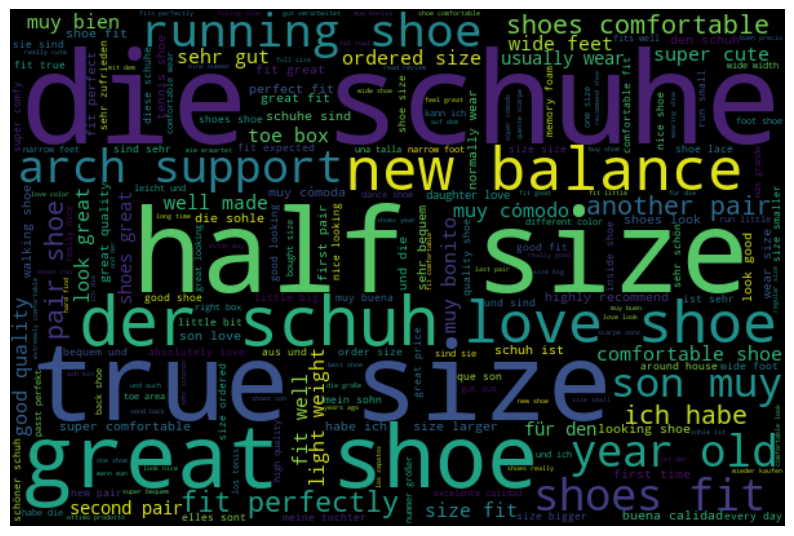

In [360]:
%matplotlib inline
import matplotlib.pyplot as plt
from wordcloud import WordCloud

wordcloud = WordCloud(width=600, 
                     height=400, 
                     random_state=2, 
                     max_font_size=100).generate(all_words_lem)

plt.figure(figsize=(10, 7))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off');

Alternative Style

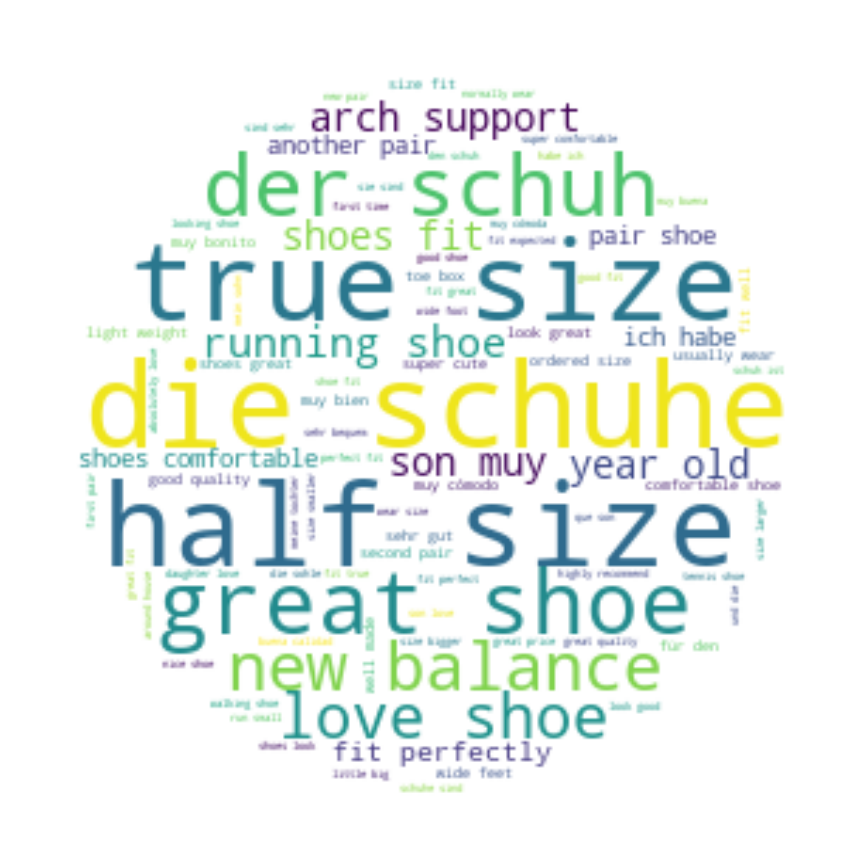

In [361]:
#Different style:
import numpy as np

x, y = np.ogrid[:300, :300]
mask = (x - 150) ** 2 + (y - 150) ** 2 > 130 ** 2
mask = 255 * mask.astype(int)

wc = WordCloud(background_color="white", repeat=True, mask=mask)
wc.generate(all_words_lem)

plt.axis("off")
plt.imshow(wc, interpolation="bilinear");

Frequency distribution

In [362]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [363]:
from nltk.tokenize import word_tokenize
from nltk.probability import FreqDist

words = nltk.word_tokenize(all_words_lem)
fd = FreqDist(words)

Most Common Words

In [366]:
#Most common words
fd.most_common(10)

[('shoes', 77520),
 ('shoe', 48090),
 ('size', 45420),
 ('comfortable', 34980),
 ('fit', 33330),
 ('und', 29520),
 ('great', 29430),
 ('like', 26970),
 ('die', 25290),
 ('feet', 24720)]

In [367]:
fd.tabulate(10)

      shoes        shoe        size comfortable         fit         und       great        like         die        feet 
      77520       48090       45420       34980       33330       29520       29430       26970       25290       24720 


Plot common words

In [368]:
#Plot common words
# Obtain top 10 words
top_10 = fd.most_common(10)

# Create pandas series to make plotting easier
fdist = pd.Series(dict(top_10))

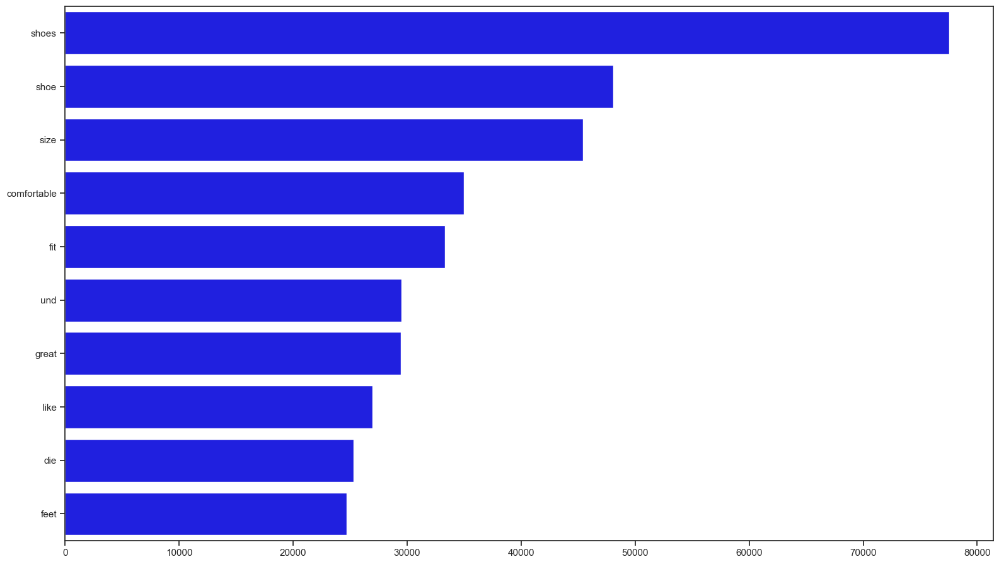

In [369]:
sns.set_theme(style="ticks")

sns.barplot(y=fdist.index, x=fdist.values, color='blue');

In [372]:
#!pip install plotly.express

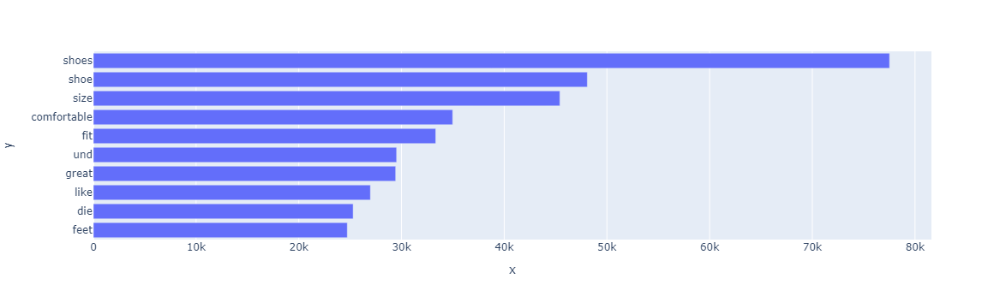

In [373]:
import plotly.express as px

fig = px.bar(y=fdist.index, x=fdist.values)

# sort values
fig.update_layout(barmode='stack', yaxis={'categoryorder':'total ascending'})

# show plot
fig.show()

Search for a specifid word

In [374]:
#Search specific words
# Show frequency of a specific word
fd["shoes"]

77520

# Sentiment Analysis

VADER lexicon
NLTK provides a simple rule-based model for general sentiment analysis called VADER, which stands for “Valence Aware Dictionary and Sentiment Reasoner” (Hutto & Gilbert, 2014).

In [375]:
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...


True

<h3>Sentiment</h3>
Sentiment Intensity Analyzer
Initialize an object of SentimentIntensityAnalyzer with name “analyzer”:

In [376]:

from nltk.sentiment import SentimentIntensityAnalyzer

analyzer = SentimentIntensityAnalyzer()

Polarity scores
Use the polarity_scores method:

In [377]:
amztok['polarity'] = amztok['text_string_lem'].apply(lambda x: analyzer.polarity_scores(x))
amztok.tail(3)

,product_name,reviewer_name,review_title,review_text,review_rating,purchase_status,review_date,scraped_at,uniq_id,review_country,review,text_token,text_string,text_string_fdist,text_string_lem,is_equal,polarity
204687,"Rohde Men's Tivoli-H Mule, 82 Anthracite, 12.5 UK",Rebecca Lützenkirchen,Einfach schöne Hausschuhe,habe sie als geschenk gekauft und sie sind seh...,5.0,Verified,2021-04-10,2021-12-24T02:29:39,5b129eb2-a438-5377-9c46-217a177615b2,Germany,5.0,"[habe, sie, als, geschenk, gekauft, und, sie, ...",habe sie als geschenk gekauft und sie sind seh...,habe sie als geschenk gekauft und sie sind seh...,habe sie als geschenk gekauft und sie sind seh...,True,"{'neg': 0.0, 'neu': 0.794, 'pos': 0.206, 'comp..."
204688,"Rohde Men's Tivoli-H Mule, 82 Anthracite, 12.5 UK",Sergej Friedel,Langlebig.,trage diese hausschuhe fast zwei monate jeden ...,5.0,Verified,2021-01-31,2021-12-24T02:29:39,91144305-98db-5a55-8ec4-16a253beb811,Germany,5.0,"[trage, diese, hausschuhe, fast, zwei, monate,...",trage diese hausschuhe fast zwei monate jeden ...,trage diese hausschuhe fast zwei monate jeden ...,trage diese hausschuhe fast zwei monate jeden ...,True,"{'neg': 0.225, 'neu': 0.72, 'pos': 0.055, 'com..."
204689,"Rohde Men's Tivoli-H Mule, 82 Anthracite, 12.5 UK",Swidurski,Hausschuhe für lange kalte Winterzeiten.,die hausschuhe sind sehr warm und tolle leder ...,5.0,Verified,2021-01-27,2021-12-24T02:29:39,5e12b707-fe18-557e-96ba-c9941b4c7690,Germany,5.0,"[die, hausschuhe, sind, sehr, warm, und, tolle...",die hausschuhe sind sehr warm und tolle leder ...,die hausschuhe sind sehr warm und tolle leder ...,die hausschuhe sind sehr warm und tolle leder ...,True,"{'neg': 0.232, 'neu': 0.655, 'pos': 0.113, 'co..."


In [380]:
amzset = amztok.copy()

Tranaform the data

In [382]:
#Transform data
# Change data structure
amzset = pd.concat(
    [amzset.drop(['purchase_status','scraped_at', 'uniq_id', 'polarity'], axis=1), 
     amzset['polarity'].apply(pd.Series)], axis=1)
amzset.head(3)

,product_name,reviewer_name,review_title,review_text,review_rating,review_date,review_country,review,text_token,text_string,text_string_fdist,text_string_lem,is_equal,neg,neu,pos,compound
0,Klasified Women's Transparent Clear Sneaker Sh...,Jocelyn McSayles,Love em,love these. was looking for converses and thes...,5.0,2020-02-06,United States,5.0,"[love, looking, converses, half, price, unique...",love looking converses half price unique never...,love looking converses half price unique never...,love looking converses half price unique never...,True,0.07,0.446,0.484,0.9188
1,Klasified Women's Transparent Clear Sneaker Sh...,Kenia Rivera,The plastic ripped,"the shoes are very cute, but after the 2nd day...",2.0,2021-10-28,United States,2.0,"[shoes, cute, 2nd, day, wearing, tongue, start...",shoes cute 2nd day wearing tongue started ripp...,shoes cute 2nd day wearing tongue started ripp...,shoes cute 2nd day wearing tongue started ripp...,True,0.00,0.836,0.164,0.6705
2,Klasified Women's Transparent Clear Sneaker Sh...,Chris Souza,Good quality,good quality,5.0,2021-01-20,United States,5.0,"[good, quality]",good quality,good quality,good quality,True,0.00,0.256,0.744,0.4404


# Create new variable with sentiment "neutral," "positive" and "negative"


In [383]:
# Create new variable with sentiment "neutral," "positive" and "negative"
amzset['sentiment'] = amzset['compound'].apply(lambda x: 'positive' if x >0 else 'neutral' if x==0 else 'negative')
amzset.head(4)

,product_name,reviewer_name,review_title,review_text,review_rating,review_date,review_country,review,text_token,text_string,text_string_fdist,text_string_lem,is_equal,neg,neu,pos,compound,sentiment
0,Klasified Women's Transparent Clear Sneaker Sh...,Jocelyn McSayles,Love em,love these. was looking for converses and thes...,5.0,2020-02-06,United States,5.0,"[love, looking, converses, half, price, unique...",love looking converses half price unique never...,love looking converses half price unique never...,love looking converses half price unique never...,True,0.07,0.446,0.484,0.9188,positive
1,Klasified Women's Transparent Clear Sneaker Sh...,Kenia Rivera,The plastic ripped,"the shoes are very cute, but after the 2nd day...",2.0,2021-10-28,United States,2.0,"[shoes, cute, 2nd, day, wearing, tongue, start...",shoes cute 2nd day wearing tongue started ripp...,shoes cute 2nd day wearing tongue started ripp...,shoes cute 2nd day wearing tongue started ripp...,True,0.00,0.836,0.164,0.6705,positive
2,Klasified Women's Transparent Clear Sneaker Sh...,Chris Souza,Good quality,good quality,5.0,2021-01-20,United States,5.0,"[good, quality]",good quality,good quality,good quality,True,0.00,0.256,0.744,0.4404,positive
3,Klasified Women's Transparent Clear Sneaker Sh...,Amazon Customer,Good,great,5.0,2021-04-22,United States,5.0,[great],great,great,great,True,0.00,0.000,1.000,0.6249,positive


<h3>Analyze data</h3><br>
Tweet with highest positive sentiment


In [384]:
#Analyze data
# Tweet with highest positive sentiment
amzset.loc[amzset['compound'].idxmax()].values

array(['ALLY UNION MAKE FORCE Mens Womens Walking Shoes Lightweight Mesh Slip-on Running Sneakers Gray Size: 8 Women/7 Men',
       'MotherOfDachshunds', 'An honest review from a Shoe Addict.',
       'the sizing chart is wierd because it\'s unisex sizing. my foot is 9"x3" and according to the listing\'s size chart, i should order a men\'s 5/woman\'s 6. however, i\'m a us woman\'s size 7/7.5 and can wear a men\'s 5.5/6.since this seller offers free returns, i went ahead and ordered the recommended size 6 (in case the sizes were men\'s) and a size 7 (in case the sizes were woman\'s) so i could compare fit.the size 6 was too snug and short. the size 7 fits well, lengthwise but is a tad wide. i kept the 7 because i wear socks and wanted to use an insole for plantars fasciitis. the shoes do not come in a box, they come in a nice little bag - which makes them perfect for returing the size 6 was as easy as taking the unpacked shoe bag to kohl\'s (although, since i have a printer, i chose to 

Tweet with highest negative sentiment 
 ...seems to be a case of wrong classification because of the word "deficit"

In [385]:
# Tweet with highest negative sentiment 
# ...seems to be a case of wrong classification because of the word "deficit"
amzset.loc[amzset['compound'].idxmin()].values

array(['BMS Raincoat 100% Waterproof - Red with White Dots - 40L - Long Arms',
       'Alexandra Reichel', 'Die Qualität hat extrem nachgelassen.',
       'ich habe zwei jacken bestellt, in farben limette und grün. die farbe limette ist wie abgebildet. dies ist geschmackssache. was ich aber zu bemängeln habe, ist der schnitt und vor allem die schlechte qualität des stoffes. ich habe die gleiche jacke (in grün), die ich schon vor ca. 4 jahren in einem store gekauft habe. die ist mir superbegleitung beim regenwetter gewesen, nur ist sie etwas in die jahre gekommen. daher habe ich mir überlegt, noch eine zu kaufen, war aber sehr enttäuscht. die grüne farbe ist etwas abgewandelt, aber das ist nicht sehr dramatisch. nur die alte jacke war aus einem sehr angenehmen und weichen wasserabweisenden stoff. die jacken, die ich hier bestellt habe, sind hart und daher stehen sie ab und schmiegen nicht an körper. ausserdem wurde offensichtlich der  schnitt geändert. die größe 36 sitzt jetzt anders, e

Visualize the data

Text(0.5, 1.0, 'Number of tweets')

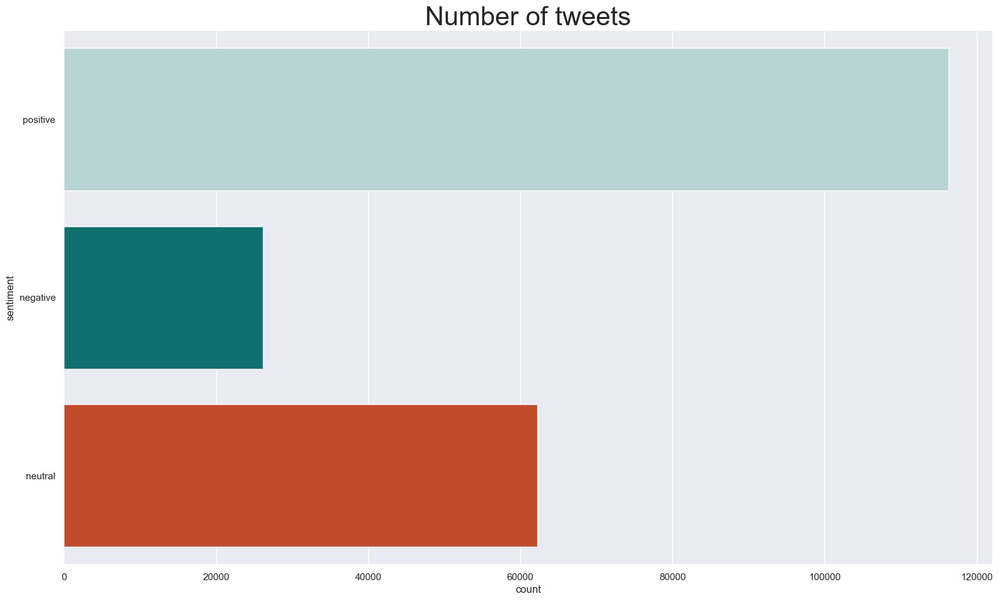

In [571]:
#Visualize data
# Number of tweets 
sns.countplot(y='sentiment', 
             data=amzset, 
             palette=['#b2d8d8',"#008080", '#db3d13']
             );
plt.title('Number of tweets',fontsize=30)

In [596]:
set_per = amzset.sentiment.value_counts()
setp = pd.DataFrame(set_per)

In [597]:
setp["percentage(%)"] = (setp.sentiment/setp.sentiment.sum())*100
setp= setp.reset_index(drop=False)
setp.rename(columns={"index":"tweet"},inplace=True)
setp

,tweet,sentiment,percentage(%)
0,positive,116280,56.807856
1,neutral,62280,30.426499
2,negative,26130,12.765646


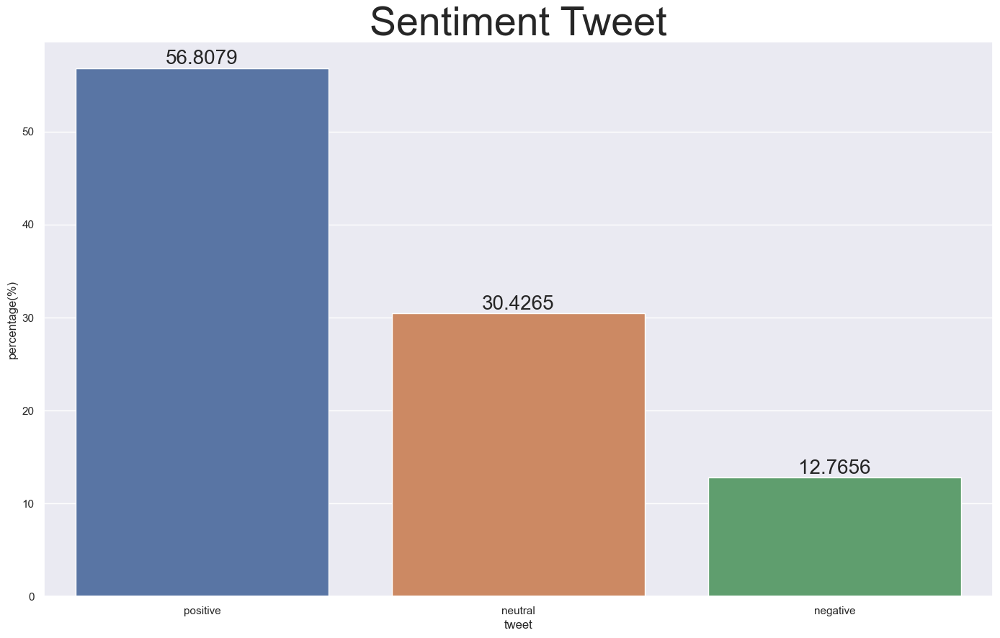

In [593]:

fig, ax = plt.subplots(figsize=(17,10))
ax.set_title('Sentiment Tweet',fontsize = 40)
ax=sns.barplot(data=setp,x='tweet',y='percentage(%)')

for l in ax.containers:
    
    ax.bar_label(l,fontsize=20)

Lineplot

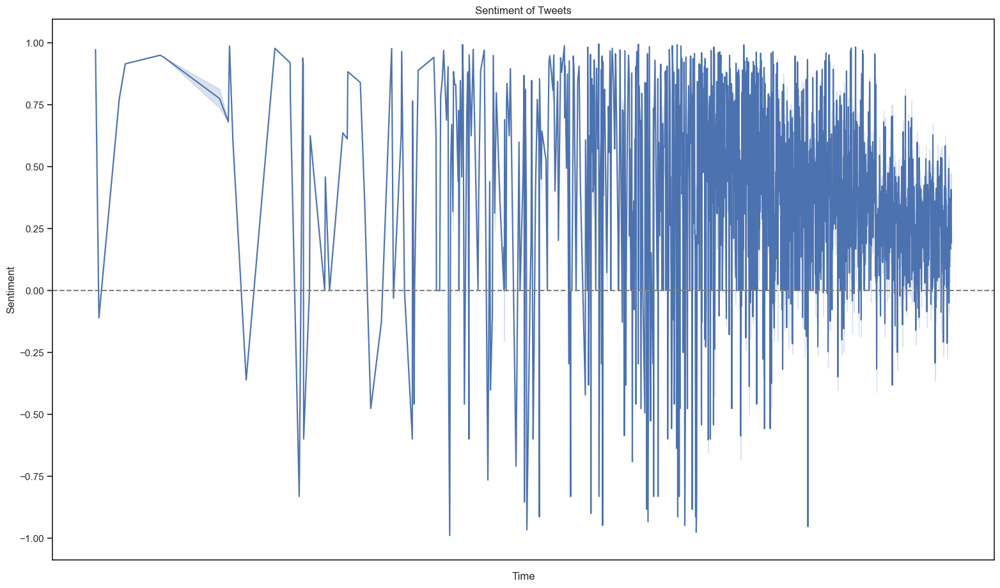

In [390]:
# Lineplot
g = sns.lineplot(x='review_date', y='compound', data=amzset)

g.set(xticklabels=[]) 
g.set(title='Sentiment of Tweets')
g.set(xlabel="Time")
g.set(ylabel="Sentiment")
g.tick_params(bottom=False)

g.axhline(0, ls='--', c = 'grey');

Box plot

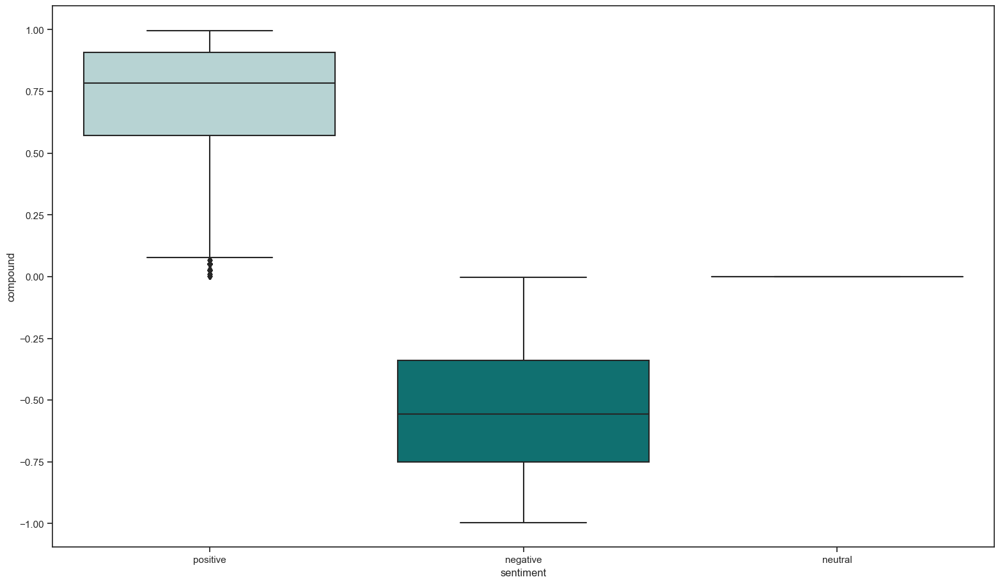

In [391]:
# Boxplot
sns.boxplot(y='compound', 
            x='sentiment',
            palette=['#b2d8d8',"#008080", '#db3d13'], 
            data=amzset);

# Step 10: Write the results back to the database.

In [392]:
review_analysed = amzset

In [395]:
review_analysed.to_csv('review_analysed.csv')

In [396]:
review_analysed.columns

Index(['product_name', 'reviewer_name', 'review_title', 'review_text',
       'review_rating', 'review_date', 'review_country', 'review',
       'text_token', 'text_string', 'text_string_fdist', 'text_string_lem',
       'is_equal', 'neg', 'neu', 'pos', 'compound', 'sentiment'],
      dtype='object')

In [527]:
from pathlib import Path

In [528]:
Path('analysed_shoes.db').touch()

In [540]:
conn1 = sqlite3.connect('analysed_shoes.db')
c1 = conn1.cursor()

In [541]:
c1.execute('''drop table if exists amazon_shoes''')

In [542]:
c1.execute('''create table amazon_shoes(product_name varchar, reviewer_name varchar, review_title varchar,review_text varchar, review_rating float,
            review_date datetime, review_country text, text_token text, text_string text, text_string_fdist text, text_string_lem text, is_equal float, negative float,
            neutral float, positive float, compound float,setiment int )''').fetchall()

review_analysed = pd.read_csv(r'C:\Users\User\PycharmProjects\MSC CONTECH STUDY\review_analysed.csv')
review_analysed.to_sql('analysed_shoes', conn, if_exists ='append', index = False)

204690

In [544]:
pd.read_sql_query("select * from sqlite_master where type = 'table';",conn)

,type,name,tbl_name,rootpage,sql
0,table,review_analysed,review_analysed,25258,"CREATE TABLE ""review_analysed"" (\n""Unnamed: 0""..."
1,table,ukShoesAmz,ukShoesAmz,270640,"CREATE TABLE ""ukShoesAmz"" (\n""Unnamed: 0"" INTE..."
2,table,shoes_reviews,shoes_reviews,2,CREATE TABLE shoes_reviews(uniq_id varchar pri...
3,table,shoes_review,shoes_review,4,"CREATE TABLE ""shoes_review"" (\n""url"" TEXT,\n ..."
4,table,analysed_shoes,analysed_shoes,368914,"CREATE TABLE ""analysed_shoes"" (\n""Unnamed: 0"" ..."


In [545]:
c1.execute("pragma table_info(amazon_shoes)").fetchall()

[(0, 'product_name', 'varchar', 0, None, 0),
 (1, 'reviewer_name', 'varchar', 0, None, 0),
 (2, 'review_title', 'varchar', 0, None, 0),
 (3, 'review_text', 'varchar', 0, None, 0),
 (4, 'review_rating', 'float', 0, None, 0),
 (5, 'review_date', 'datetime', 0, None, 0),
 (6, 'review_country', 'TEXT', 0, None, 0),
 (7, 'text_token', 'TEXT', 0, None, 0),
 (8, 'text_string', 'TEXT', 0, None, 0),
 (9, 'text_string_fdist', 'TEXT', 0, None, 0),
 (10, 'text_string_lem', 'TEXT', 0, None, 0),
 (11, 'is_equal', 'float', 0, None, 0),
 (12, 'negative', 'float', 0, None, 0),
 (13, 'neutral', 'float', 0, None, 0),
 (14, 'positive', 'float', 0, None, 0),
 (15, 'compound', 'float', 0, None, 0),
 (16, 'setiment', 'INT', 0, None, 0)]

In [546]:
shoes = pd.read_sql("select count(*) as [Total Rows] from analysed_shoes",conn)
shoes.head

<bound method NDFrame.head of    Total Rows
0      614070>

<h1>STEP 11: The Final Report</h1>


A Dataset of 22588 columns and 11 rows was collected from data.world.gov. The dataset contains customer ratings and feedback from the Uk Amazon shoe store. The analysis aims to ascertain customers' habits towards shoe shopping to help amazon and its partners understand where and when to improve their products and services.
To achieve these goals, the researcher came up with some research questions that will enable him to achieve his goal. The following questions are;
•	Which are the top 5 countries that gave a 5-star review?
•	Which countries gave the least (1 star) negative rating?
•	What are the trends and relationships in customer rating?
•	What is customer feedback upon utilizing a product?
Which are the top 5 countries that gave a 5-star review?
From the analysis found, the top 5-star countries are;

TOP 5 Countries	Rating Percentage (%)	Rating Count
1.	USA	48.2	67340
2.	Germany	19.0	26603
3.	Canada	12.1	16872
4.	Mexico	11.3	15799
5.	Italy	9.42	13172
 

Which countries gave the least (1 star) negative rating?
Least 5-star countries	Rating (%)	Rating count
USA	53.2	12876
Germany	13.1	3182
Canada	10.0	2331
Spain	7.2	1739
Italy	5.7	1369

What are the trends and relationships in the rating?
In 2011 – 2012, there was a stable upward trend in the data. From 2012 to early 2013, there was no trend until mid-2013, when there was a downward trend in customer ratings for various countries of about 59.2%. The rating dropped drastically in 2014 to 71.3%. In a month’s interval, an upward trend was about 75%. There was no trend in customer rating until late 2014 when there was an upward and downward trend.
Who are the Top 5 customers with 5-star ratings?
Reviewer	Reviewer Country	Rating	Percentage (%)
1.	Amazon customer	USA	5.0	42.0
2.	Amazon Kunde	Germany	5.0	18.0
3.	Amazon Customer	Canada	5.0	15.0
4.	Cliente Amazon	Italy	5.0	14.0
5.	Cliente Amazon	Spain	5.0	11.2

Who are the Top 5 customers with the 1-star rating?
•	Review_Country      Review_Rating   Review_Rating(%)
1.	United States          10440         53.211009
2.	Germany           	   2580          13.149847
3.	Canada           	   1890          9.633028
4.	Spain                  1410          7.186544
5.	Italy                  1110          5.657492


What is customer feedback upon utilizing a product?
Our analysis shows that 56.8% of amazon customers had positive feedback or negative sentiments after utilizing each product. 30.4% of customers’ sentiment were neutral while 12.6% was negative.

Conclusion
amazon shoe store has impressed its customers over time based on analysis but still needs to improve its services.

Recommendation
•	Know your esteemed customers: it is important you try to find out how your product serves your customer and if it doesn’t try to replace some and ensure a money-back guarantee. It does matter if the customer buys in small quantities if the product meets his or her satisfaction he/she may order more or recommend friends.
•	Keep your customers: Bad products or inadequate services ranging from customer care rep and beyond discourages customers. This will make them place a negative review that may discourage pontential customers.
•	Be polite: serve your customer with humility and friendly conversation to encourage them to buy more.
•	Product must reflect company integrity: Improve product quality and customer satisfaction. Give accurate information about your product since the shopping is done online to avoid misleading your customers and potential customers.


Thanks professor: 
Pls kindly place a five star in my email box if you like my and pls do not hesitate to tell me where I need to improve on. 
This project is subject to further analysis and research.






